# Image Manipulations and Image Spaces

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from skimage import color
import os

In [3]:
# Read an image
original_image = Image.open("./test_images/100007.jpg")

# Show the image
original_image.show()

In [4]:
# Transform the image to numpy array to manipulate it
image_array = np.array(original_image)

# Inspect the image array
print(f"Shape: {image_array.shape}")
print(f"Red channel:\n{image_array[:, :, 0]}")
print(f"Green channel:\n{image_array[:, :, 1]}")
print(f"Blue channel:\n{image_array[:, :, 2]}")

Shape: (321, 481, 3)
Red channel:
[[ 55  56  57 ...  27  22  25]
 [ 51  53  55 ...  27  23  23]
 [ 53  56  60 ...  33  21  23]
 ...
 [153 152 149 ...  51  47  44]
 [186 192 190 ...  52  47  43]
 [171 170 165 ...  53  47  41]]
Green channel:
[[ 73  74  75 ...  37  32  31]
 [ 69  71  73 ...  38  32  32]
 [ 71  74  78 ...  48  33  32]
 ...
 [147 146 143 ...  52  50  47]
 [180 186 184 ...  53  48  46]
 [164 164 158 ...  53  49  44]]
Blue channel:
[[ 73  74  75 ...  29  24  27]
 [ 69  71  73 ...  32  27  27]
 [ 73  76  80 ...  45  31  29]
 ...
 [151 148 147 ...  46  41  40]
 [184 188 188 ...  45  40  39]
 [171 168 165 ...  45  38  35]]


In [5]:
# Manipulation example: make the image darker
image_array_v1 = (image_array * 0.6).astype(np.uint8)
image_v1_darker = Image.fromarray(image_array_v1)
image_v1_darker.show()

In [6]:
# Manipulation example: manipulate the red channel
image_array_v2 = image_array[:, :, 0]
image_v2 = Image.fromarray(image_array_v2)
image_v2.show()
# Why is it grey?


In [7]:

image_array_v2 = image_array.copy()
image_array_v2[:, :, 1] = 0  # Set green channel to 0
image_array_v2[:, :, 2] = 0  # Set blue channel to 0
image_v2 = Image.fromarray(image_array_v2)
image_v2.show()

In [8]:
# Transform RGB array to Lab array
from skimage.color import rgb2lab, lab2rgb

image_array_lab = rgb2lab(image_array)
# Inspect the image array
print(f"Shape: {image_array_lab.shape}")
print(f"L channel:\n{image_array_lab[:, :, 0]}")
print(f"a channel:\n{image_array_lab[:, :, 1]}")
print(f"b channel:\n{image_array_lab[:, :, 2]}")

# Transform Lab array to RGB array
image_array_rgb = lab2rgb(image_array_lab)

# Inspect the image array
print(f"Shape: {image_array_rgb.shape}")
print(f"Red channel:\n{image_array_rgb[:, :, 0]}")
print(f"Green channel:\n{image_array_rgb[:, :, 1]}")
print(f"Blue channel:\n{image_array_rgb[:, :, 2]}")

# Show the image
image = Image.fromarray((image_array_rgb * 255).astype(np.uint8))
image.show()

Shape: (321, 481, 3)
L channel:
[[29.5586996  29.99167054 30.42367599 ... 13.50060451 11.06059437
  11.03387094]
 [27.81691004 28.68981165 29.5586996  ... 13.96354868 11.2354406
  11.2354406 ]
 [28.75769227 30.05891723 31.78046831 ... 18.48178462 11.59361739
  11.30241975]
 ...
 [61.54556334 61.10806025 60.01608738 ... 21.42062442 20.22577176
  18.89299627]
 [73.89616847 76.04183982 75.36361786 ... 21.82019967 19.52158372
  18.42680655]
 [68.13048212 67.96476658 65.88065315 ... 21.9175385  19.80572915
  17.43291089]]
a channel:
[[-7.04607063 -7.03540805 -7.02479132 ... -6.51191016 -6.63538726
  -3.81737477]
 [-7.08913302 -7.06752453 -7.04607063 ... -6.42130735 -5.41687343
  -5.41687343]
 [-6.53321146 -6.50802069 -6.4744622  ... -7.05470126 -5.82829524
  -4.87507952]
 ...
 [ 2.95842392  2.58009421  2.97329302 ... -1.78067108 -3.33866999
  -2.94003879]
 [ 2.85039568  2.46658441  2.83880087 ... -2.19457511 -2.22117176
  -2.9490557 ]
 [ 3.82416225  2.89979345  3.85029823 ... -1.73703869 -3

In [9]:
# Transform RGB to HSV
from skimage.color import rgb2hsv, hsv2rgb

image_array_hsv = rgb2hsv(image_array)
# Inspect the image array
print(f"Shape: {image_array_hsv.shape}")
print(f"H channel:\n{image_array_hsv[:, :, 0]}")
print(f"S channel:\n{image_array_hsv[:, :, 1]}")
print(f"V channel:\n{image_array_hsv[:, :, 2]}")

# Histogram equalization on the V channel
from skimage.exposure import equalize_hist

image_array_hsv[:, :, 2] = equalize_hist(image_array_hsv[:, :, 2])
print(f"V channel after equalization:\n{image_array_hsv[:, :, 2]}")

# Transform HSV to RGB
image_array_rgb = hsv2rgb(image_array_hsv)

# Show the image
image = Image.fromarray((image_array_rgb * 255).astype(np.uint8))
image.show()

Shape: (321, 481, 3)
H channel:
[[0.5        0.5        0.5        ... 0.36666667 0.36666667 0.38888889]
 [0.5        0.5        0.5        ... 0.40909091 0.40740741 0.40740741]
 [0.51666667 0.51666667 0.51666667 ... 0.46666667 0.47222222 0.44444444]
 ...
 [0.88888889 0.94444444 0.88888889 ... 0.19444444 0.22222222 0.23809524]
 [0.88888889 0.94444444 0.88888889 ... 0.1875     0.1875     0.23809524]
 [0.83333333 0.88888889 0.83333333 ... 0.16666667 0.1969697  0.22222222]]
S channel:
[[0.24657534 0.24324324 0.24       ... 0.27027027 0.3125     0.19354839]
 [0.26086957 0.25352113 0.24657534 ... 0.28947368 0.28125    0.28125   ]
 [0.2739726  0.26315789 0.25       ... 0.3125     0.36363636 0.28125   ]
 ...
 [0.03921569 0.03947368 0.04026846 ... 0.11538462 0.18       0.14893617]
 [0.03225806 0.03125    0.03157895 ... 0.1509434  0.16666667 0.15217391]
 [0.04093567 0.03529412 0.04242424 ... 0.1509434  0.2244898  0.20454545]]
V channel:
[[0.28627451 0.29019608 0.29411765 ... 0.14509804 0.125490

# Compute Power

In [10]:
def compute_power(image):
    img = image.astype(np.float64)
    gamma = 0.7755
    w0 = 1.48169521e-6
    w_r = 2.13636845e-7
    w_g = 1.77746705e-7
    w_b = 2.14348309e-7
    
    r_pow = w_r * np.power(img[:, :, 0], gamma)
    g_pow = w_g * np.power(img[:, :, 1], gamma)
    b_pow = w_b * np.power(img[:, :, 2], gamma)
    
    return w0 + np.sum(r_pow + g_pow + b_pow)

# Compute Distortion

In [11]:
def compute_distortion(original_img,modified_img):
    if original_img.shape != modified_img.shape:
        original_img = original_img[:,:,:3]
        modified_img = modified_img[:,:,:3]

    lab_orig = color.rgb2lab(original_img)
    lab_mod = color.rgb2lab(modified_img)
    
    diff = lab_orig - lab_mod
    dist_pixel = np.sqrt(np.sum(np.square(diff), axis=2))
    total_error = np.sum(dist_pixel)
    
    h, w, _ = original_img.shape
    max_dist = np.sqrt(100**2 + 255**2 + 255**2)
    
    return (total_error / (h * w * max_dist)) * 100


In [12]:


power_result_original=compute_power(np.array(original_image))
power_result_v1=compute_power(np.array(image_v1_darker))
distortion_result=compute_distortion(np.array(original_image),np.array(image_v1_darker))

print(power_result_original)
print(power_result_v1)
print(distortion_result)

5.016254929773464
3.365048261740193
7.065601800816261


# DVS

In [13]:
def compute_pixel_current():
    raise NotImplementedError

In [14]:
def compute_panel_power():
    raise NotImplementedError

In [15]:
from typing import Tuple

def displayed_image(
        i_cell: np.ndarray,
        vdd: float,
        p1: float = 4.251e-5,
        p2: float = -3.029e-4,
        p3: float = 3.024e-5,
        orig_vdd: float = 15,
        ) -> Tuple[np.ndarray, np.ndarray]:
    """
    Display an image on the OLED display taking into account the effect of DVS.

    :param i_cell: An array of the currents drawn by each pixel of the display.
    :param vdd: The new voltage of the display.
    """
    i_cell_max = (p1 * vdd * 1) + (p2 * 1) + p3
    image_rgb_max = (i_cell_max - p3) / (p1 * orig_vdd + p2) * 255
    out = np.round((i_cell - p3) / (p1 * orig_vdd + p2) * 255)
    original_image = out.copy()

    # Clip the values exceeding `i_cell_max` to `image_rgb_max`
    out[i_cell > i_cell_max] = image_rgb_max

    return original_image.astype(np.uint8), out.astype(np.uint8)

In [16]:
from scipy.io import loadmat

# Load the .mat file
mat_data = loadmat('sample_cell_current.mat')["I_cell_sample"]

# Inspect the loaded data
print(f"Shape: {mat_data.shape}")
print(f"Red channel:\n{mat_data[:, :, 0]}")
print(f"Green channel:\n{mat_data[:, :, 1]}")
print(f"Blue channel:\n{mat_data[:, :, 2]}")

image_array_orig, image_array_w_dvs = displayed_image(mat_data, 10)
image_orig = Image.fromarray(image_array_orig)
image_orig.show()
image_w_dvs = Image.fromarray(image_array_w_dvs)
image_w_dvs.show()


Shape: (176, 220, 3)
Red channel:
[[2.46842941e-04 2.24526275e-04 2.03522353e-04 ... 9.45645098e-05
  9.45645098e-05 9.45645098e-05]
 [2.46842941e-04 2.24526275e-04 2.03522353e-04 ... 9.45645098e-05
  9.45645098e-05 9.45645098e-05]
 [2.46842941e-04 2.24526275e-04 2.03522353e-04 ... 9.45645098e-05
  9.45645098e-05 9.45645098e-05]
 ...
 [2.88850784e-04 2.78348824e-04 2.67846863e-04 ... 3.32171373e-04
  3.21669412e-04 3.21669412e-04]
 [2.88850784e-04 2.78348824e-04 2.67846863e-04 ... 3.32171373e-04
  3.32171373e-04 3.21669412e-04]
 [2.88850784e-04 2.78348824e-04 2.67846863e-04 ... 3.32171373e-04
  3.32171373e-04 3.11167451e-04]]
Green channel:
[[1.41823333e-04 1.20819412e-04 1.10317451e-04 ... 7.22478431e-05
  6.69968627e-05 6.69968627e-05]
 [1.36572353e-04 1.26070392e-04 1.10317451e-04 ... 7.22478431e-05
  6.69968627e-05 6.69968627e-05]
 [1.31321373e-04 1.20819412e-04 1.10317451e-04 ... 7.22478431e-05
  6.69968627e-05 6.69968627e-05]
 ...
 [1.73329216e-04 1.62827255e-04 1.57576275e-04 ..

In [17]:
def estimate_power_part1(img):
    return compute_power(img) 

In [18]:
def apply_hungry_blue(img, k):
    img_mod = img.astype(np.int16) #default uint8[0,255] underflow
    img_mod[:, :, 2] = img_mod[:, :, 2] - k
    img_mod = np.clip(img_mod, 0, 255) 
    return img_mod.astype(np.uint8)

In [19]:
#load images function
def load_images_from_folder(folder_path, limit=50):
    images_list = []
    
    valid_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.tiff')
    
    try:
        filenames = os.listdir(folder_path)
    except FileNotFoundError:
        print(f"错误: 找不到文件夹 '{folder_path}'")
        return []

    filenames.sort()

    count = 0
    print(f"正在从 {folder_path} 加载图片...")

    for filename in filenames:
        if count >= limit:
            break
        
        if filename.lower().endswith(valid_extensions):
            file_path = os.path.join(folder_path, filename)
            
            try:
                with Image.open(file_path) as img:
                    img_rgb = img.convert('RGB')
                    
                    img_array = np.array(img_rgb)
                    
                    images_list.append(img_array)
                    count += 1
                    
            except Exception as e:
                print(f"无法加载图片 {filename}: {e}")

    print(f"成功加载 {len(images_list)} 张图片。")
    return images_list

In [20]:
my_folder_path="./test_images"
images = load_images_from_folder(my_folder_path, limit=50)
screen_folder_path="./myscreen"
screen_images = load_images_from_folder(screen_folder_path, limit=5)

all_images = images + screen_images


正在从 ./test_images 加载图片...


成功加载 50 张图片。
正在从 ./myscreen 加载图片...
成功加载 5 张图片。


正在处理自然图像组 (50张)...
正在处理屏幕截图组 (5张)...


/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: divide by zero encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)
/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: overflow encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)
/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: invalid value encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)


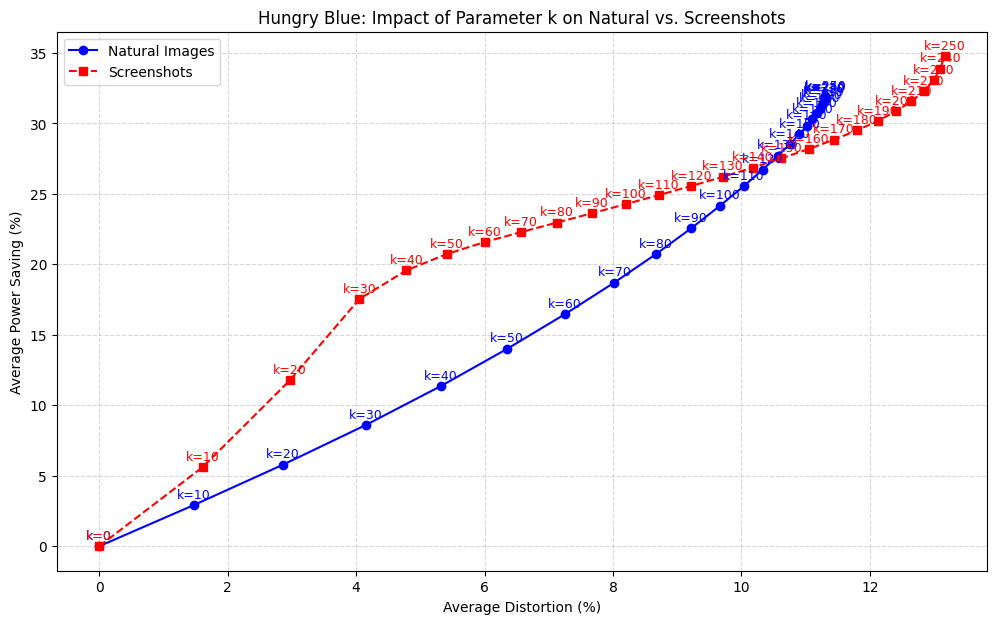

In [21]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# 定义要测试的 k 值范围
k_values = range(0, 256, 10) 

def run_hungry_blue_experiment(image_list):
    """通用函数：对一组图片运行 Hungry Blue 并返回平均统计数据"""
    avg_results = []
    for k in k_values:
        savings = []
        distortions = []
        for img in image_list:
            # 1. 计算原始功耗
            p_orig = estimate_power_part1(img)
            # 2. 应用变换
            img_new = apply_hungry_blue(img, k)
            # 3. 计算新功耗和失真
            p_new = estimate_power_part1(img_new)
            dist = compute_distortion(img, img_new)
            # 4. 记录节能率
            savings.append((p_orig - p_new) / p_orig * 100 if p_orig > 0 else 0)
            distortions.append(dist)
        # 返回该 k 值下的平均 (失真, 节能)
        avg_results.append((np.mean(distortions), np.mean(savings)))
    return avg_results

# --- 分别对两组运行实验 ---
print("正在处理自然图像组 (50张)...")
results_natural = run_hungry_blue_experiment(images)

print("正在处理屏幕截图组 (5张)...")
results_screenshots = run_hungry_blue_experiment(screen_images)

# --- 可视化对比 ---
plt.figure(figsize=(12, 7))

# --- 绘制自然图像组 ---
x_nat = [r[0] for r in results_natural]
y_nat = [r[1] for r in results_natural]
plt.plot(x_nat, y_nat, 'b-o', label='Natural Images')

# 给自然图像组的点打标签
for i, k in enumerate(k_values):
    plt.text(x_nat[i], y_nat[i] + 0.5, f'k={k}', color='blue', fontsize=9, ha='center')

# --- 绘制屏幕截图组 ---
x_scr = [r[0] for r in results_screenshots]
y_scr = [r[1] for r in results_screenshots]
plt.plot(x_scr, y_scr, 'r--s', label='Screenshots')

# 给截图组的点打标签
for i, k in enumerate(k_values):
    plt.text(x_scr[i], y_scr[i] + 0.5, f'k={k}', color='red', fontsize=9, ha='center')

plt.title('Hungry Blue: Impact of Parameter k on Natural vs. Screenshots')
plt.xlabel('Average Distortion (%)')
plt.ylabel('Average Power Saving (%)')
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()
plt.show()

正在计算白色背景截图...
正在计算黑色背景截图...


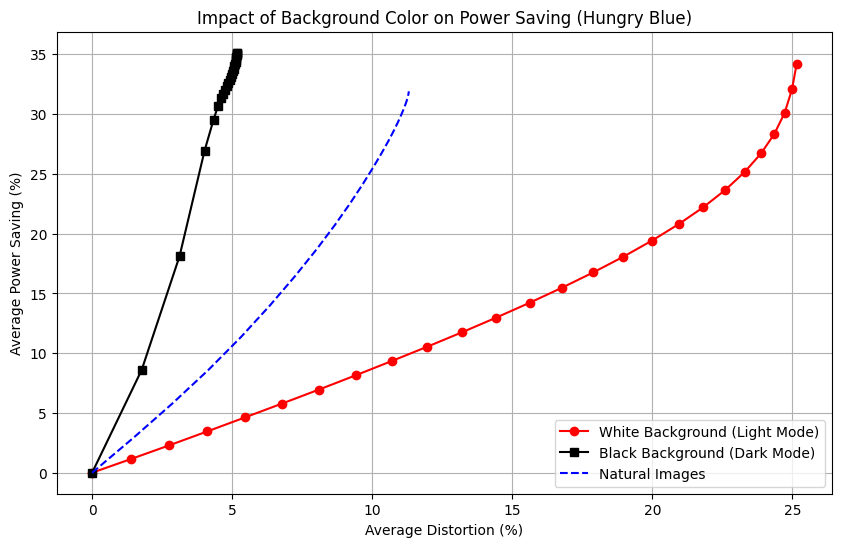

In [22]:
# 假设你的 screen_images 列表顺序是 [#1(白), #2(黑), #3(白), #4(黑), #5(黑)]
white_screens = [screen_images[0], screen_images[2]]
black_screens = [screen_images[1], screen_images[3], screen_images[4]]

print("正在计算白色背景截图...")
results_white = run_hungry_blue_experiment(white_screens)

print("正在计算黑色背景截图...")
results_black = run_hungry_blue_experiment(black_screens)

# 绘图对比
plt.figure(figsize=(10, 6))
plt.plot([r[0] for r in results_white], [r[1] for r in results_white], 'r-o', label='White Background (Light Mode)')
plt.plot([r[0] for r in results_black], [r[1] for r in results_black], 'k-s', label='Black Background (Dark Mode)')
plt.plot([r[0] for r in results_natural], [r[1] for r in results_natural], 'b--', label='Natural Images')

plt.title('Impact of Background Color on Power Saving (Hungry Blue)')
plt.xlabel('Average Distortion (%)')
plt.ylabel('Average Power Saving (%)')
plt.legend()
plt.grid(True)
plt.show()

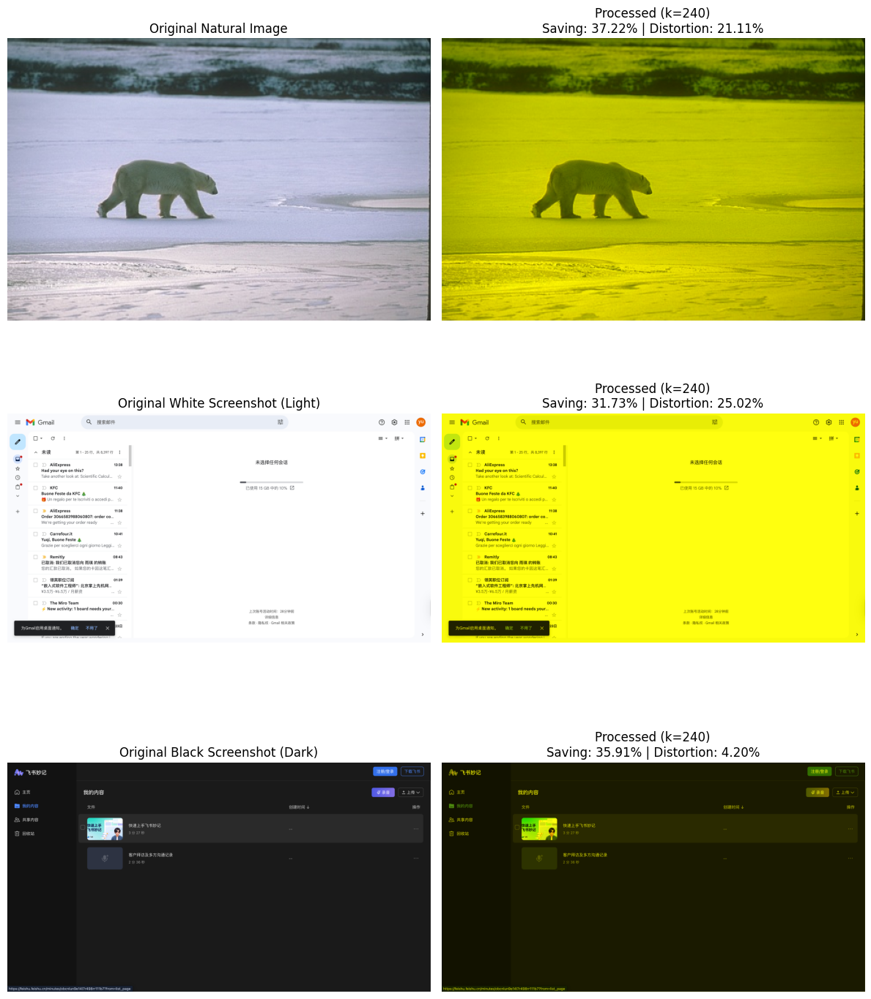

In [23]:
import matplotlib.pyplot as plt

# 1. 设置参数 k
target_k = 240

# 2. 挑选代表性图片
# 自然图像选第一张
img_natural = images[0]
# 白底截图选 #3 (索引为 2)
img_white_scr = screen_images[2]
# 黑底截图选 #4 (索引为 3)
img_black_scr = screen_images[3]

selected_images = [
    ("Natural Image", img_natural),
    ("White Screenshot (Light)", img_white_scr),
    ("Black Screenshot (Dark)", img_black_scr)
]

# 3. 创建画布 (3行2列)
fig, axes = plt.subplots(3, 2, figsize=(12, 15))

for i, (name, img) in enumerate(selected_images):
    # 计算原始功耗
    p_orig = estimate_power_part1(img)
    
    # 应用 Hungry Blue (k=240)
    img_proc = apply_hungry_blue(img, target_k)
    
    # 计算处理后指标
    p_new = estimate_power_part1(img_proc)
    saving = (p_orig - p_new) / p_orig * 100
    dist = compute_distortion(img, img_proc)
    
    # 绘制原图
    axes[i, 0].imshow(img)
    axes[i, 0].set_title(f"Original {name}")
    axes[i, 0].axis('off')
    
    # 绘制处理后的图
    axes[i, 1].imshow(img_proc)
    axes[i, 1].set_title(f"Processed (k={target_k})\nSaving: {saving:.2f}% | Distortion: {dist:.2f}%")
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()

In [24]:
for i, img in enumerate(screen_images):
    p_orig = compute_power(img)
    print(f"Screenshot #{i+1} 原始功耗: {p_orig:.6f}")

Screenshot #1 原始功耗: 189.706308
Screenshot #2 原始功耗: 56.317515
Screenshot #3 原始功耗: 202.966805
Screenshot #4 原始功耗: 38.300346
Screenshot #5 原始功耗: 41.777083


In [25]:
# 为 Hungry Blue 构建逐图详细数据，提供detailed_data
detailed_data = {}

for k in k_values:
    current_k_stats = []
    for idx, img in enumerate(all_images):
        p_orig = estimate_power_part1(img)
        img_new = apply_hungry_blue(img, k)
        p_new = estimate_power_part1(img_new)
        saving = (p_orig - p_new) / p_orig * 100 if p_orig > 0 else 0
        dist = compute_distortion(img, img_new)
        current_k_stats.append({'idx': idx, 'saving': saving, 'dist': dist})
    detailed_data[k] = current_k_stats

print(f"detailed_data 构建完成：{len(detailed_data)} 个 k 值，每个 {len(next(iter(detailed_data.values())))} 张图片")


detailed_data 构建完成：26 个 k 值，每个 55 张图片


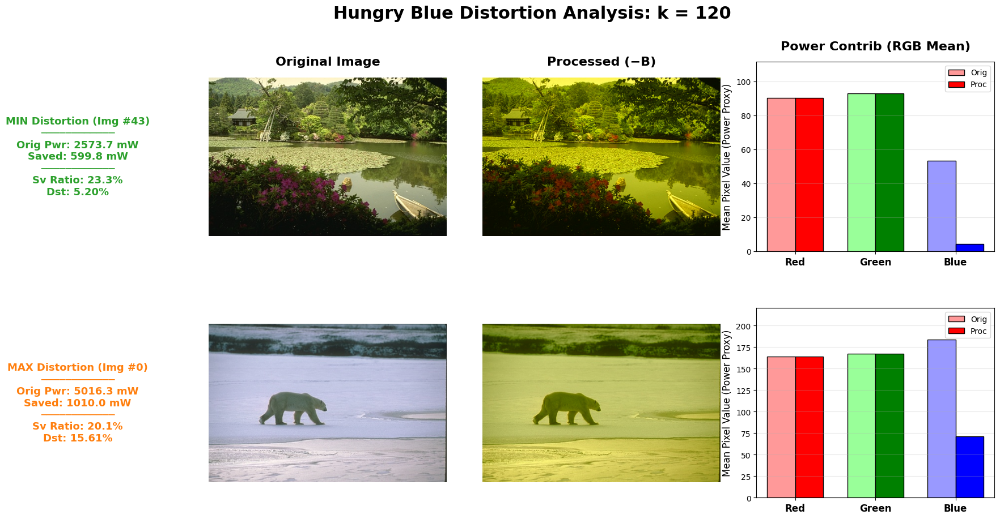

In [77]:
import numpy as np
import matplotlib.pyplot as plt

# ==================== 【新增：根据课件公式计算功耗】 ====================
def calculate_power_mw(img):
    """
    根据 Lab2 PDF 第 23 页的功耗模型计算图像总功耗 (单位转为毫瓦 mW)
    """
    Y = 0.7755
    W0 = 1.48169521e-6
    WR = 2.13636845e-7
    WG = 1.77746705e-7
    WB = 2.14348309e-7
    
    # 转换为 float 以防整数溢出
    img_float = img.astype(float)
    R = img_float[:,:,0]
    G = img_float[:,:,1]
    B = img_float[:,:,2]
    
    # 计算所有像素的功耗总和
    P_pixels = WR * (R ** Y) + WG * (G ** Y) + WB * (B ** Y)
    P_total_watts = W0 + np.sum(P_pixels)
    
    return P_total_watts * 1000  # 将瓦特 (W) 转换为毫瓦 (mW) 更易读
# ========================================================================

def plot_simplified_analysis(k, stats, images):
    # 过滤超出范围的 idx
    valid_stats = [s for s in stats if s['idx'] < len(images)]
    
    if not valid_stats:
        print("错误：传入的数据中没有与当前图片列表匹配的 idx！")
        return

    # 筛选极值，作为代表性示例展示
    min_dist = min(valid_stats, key=lambda x: x['dist'])
    max_dist = max(valid_stats, key=lambda x: x['dist'])
    cases = [('MIN Distortion', min_dist, '#2ca02c'), 
             ('MAX Distortion', max_dist, '#ff7f0e')]

    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    fig.suptitle(f'Hungry Blue Distortion Analysis: k = {k} ', fontsize=22, fontweight='bold', y=0.98)

    col_titles = ['Original Image', 'Processed (−B)', 'Power Contrib (RGB Mean)']
    for ci, ct in enumerate(col_titles):
        axes[0, ci].set_title(ct, fontsize=16, fontweight='bold', pad=15)

    for row, (label, stat, color_code) in enumerate(cases):
        idx = stat['idx']
        img_orig = images[idx]
        
        # 应用算法 (确保你的环境中已定义该函数)
        img_proc = apply_hungry_blue(img_orig, k) 

        # 计算绝对功耗
        p_orig_mw = calculate_power_mw(img_orig)
        p_proc_mw = calculate_power_mw(img_proc)
        p_saved_mw = p_orig_mw - p_proc_mw

        # 左侧数据标签：新增绝对功耗对比
        ax_label = axes[row, 0]
        label_str = (f"{label} (Img #{idx})\n"
                     f"────────────\n"
                     f"Orig Pwr: {p_orig_mw:.1f} mW\n"
                     f"Saved: {p_saved_mw:.1f} mW\n"
                     f"────────────\n"
                     f"Sv Ratio: {stat['saving']:.1f}%\n"
                     f"Dst: {stat['dist']:.2f}%")
        
        # 稍微向左平移文字，防止和图片重叠
        ax_label.text(-0.55, 0.5, label_str, transform=ax_label.transAxes, 
                      fontsize=13, fontweight='bold', color=color_code, ha='center', va='center',
                      bbox=dict(facecolor='white', alpha=0.8, edgecolor='none', pad=5))

        # 1. 原图
        axes[row, 0].imshow(img_orig)
        axes[row, 0].axis('off')

        # 2. 处理图
        axes[row, 1].imshow(img_proc)
        axes[row, 1].axis('off')

        # 3. 功耗占比柱状图 
        ax_bar = axes[row, 2]
        orig_means = [img_orig[:,:,0].mean(), img_orig[:,:,1].mean(), img_orig[:,:,2].mean()]
        proc_means = [img_proc[:,:,0].mean(), img_proc[:,:,1].mean(), img_proc[:,:,2].mean()]
        
        x = np.arange(3)
        width = 0.35
        ax_bar.bar(x - width/2, orig_means, width, label='Orig', color=['#ff9999', '#99ff99', '#9999ff'], edgecolor='black')
        ax_bar.bar(x + width/2, proc_means, width, label='Proc', color=['red', 'green', 'blue'], edgecolor='black')
        
        ax_bar.set_xticks(x)
        ax_bar.set_xticklabels(['Red', 'Green', 'Blue'], fontweight='bold', fontsize=12)
        ax_bar.legend(loc='upper right', fontsize=10)
        ax_bar.grid(axis='y', alpha=0.3)
        ax_bar.set_ylabel('Mean Pixel Value (Power Proxy)', fontsize=12)
        ax_bar.set_ylim(0, max(max(orig_means), max(proc_means)) * 1.2)

    plt.subplots_adjust(left=0.18, right=0.95, wspace=0.15, hspace=0.3)
    plt.show()

# 调用示例：
if 120 in detailed_data:
    plot_simplified_analysis(120, detailed_data[120], images)

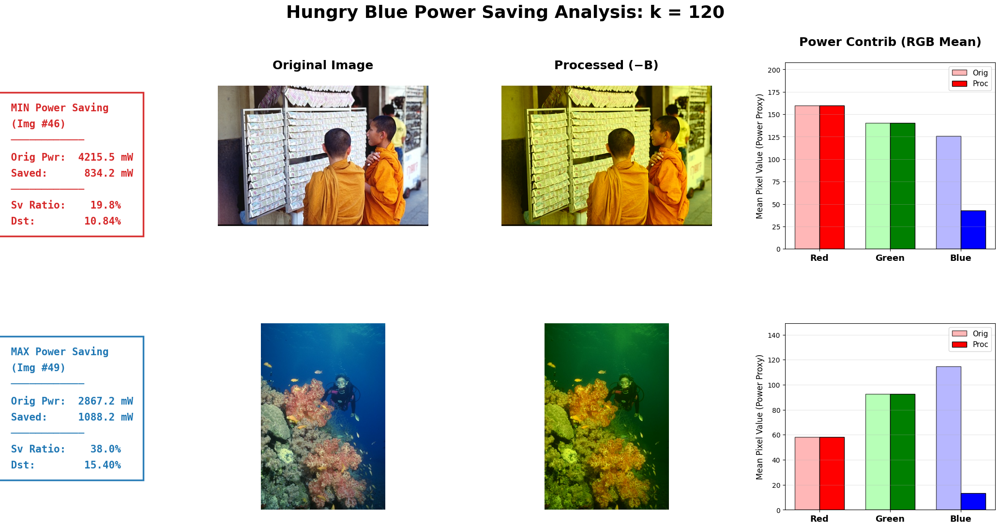

In [91]:
import numpy as np
import matplotlib.pyplot as plt

def calculate_power_mw(img):
    """
    根据实验手册 Part 1 的 OLED 物理模型计算图像总功耗 (单位: mW)
    """
    # 功耗模型系数
    Y = 0.7755
    W0 = 1.48169521e-6
    WR = 2.13636845e-7
    WG = 1.77746705e-7
    WB = 2.14348309e-7
    
    img_float = img.astype(float)
    R, G, B = img_float[:,:,0], img_float[:,:,1], img_float[:,:,2]
    
    # 基于单个像素的 R, G, B 分量计算功耗
    P_pixels = WR * (R ** Y) + WG * (G ** Y) + WB * (B ** Y)
    P_total_watts = W0 + np.sum(P_pixels)
    
    return P_total_watts * 1000  # W 转换为 mW

def plot_saving_analysis(k, stats, images):
    """
    可视化省电分析：修复文字对齐问题，适配不同纵横比的图片
    """
    valid_stats = [s for s in stats if s['idx'] < len(images)]
    if not valid_stats:
        print("错误：数据不匹配")
        return

    # 筛选省电率的极值
    min_stat = min(valid_stats, key=lambda x: x['saving'])
    max_stat = max(valid_stats, key=lambda x: x['saving'])
    cases = [('MIN Power Saving', min_stat, '#d62728'), 
             ('MAX Power Saving', max_stat, '#1f77b4')]

    fig, axes = plt.subplots(2, 3, figsize=(22, 12))
    fig.suptitle(f'Hungry Blue Power Saving Analysis: k = {k}', fontsize=26, fontweight='bold', y=0.98)

    col_titles = ['Original Image', 'Processed (−B)', 'Power Contrib (RGB Mean)']
    for ci, ct in enumerate(col_titles):
        axes[0, ci].set_title(ct, fontsize=18, fontweight='bold', pad=25)

    for row, (label, stat, color_code) in enumerate(cases):
        idx = stat['idx']
        img_orig = images[idx]
        # 注意：此处假设 apply_hungry_blue 已在外部定义
        img_proc = apply_hungry_blue(img_orig, k) 

        # 计算绝对功耗数据
        p_orig_mw = calculate_power_mw(img_orig)
        p_proc_mw = calculate_power_mw(img_proc)
        p_saved_mw = p_orig_mw - p_proc_mw

        # 标注文本信息（使用等宽字符对齐数字）
        label_str = (f" {label}\n"
                     f" (Img #{idx})\n"
                     f" ────────────\n"
                     f" Orig Pwr: {p_orig_mw:>7.1f} mW\n"
                     f" Saved:    {p_saved_mw:>7.1f} mW\n"
                     f" ────────────\n"
                     f" Sv Ratio: {stat['saving']:>7.1f}%\n"
                     f" Dst:      {stat['dist']:>7.2f}%")
        
        # ==================== 【对齐修复关键：使用 Figure 坐标】 ====================
        ax_label = axes[row, 0]
        # 获取子图在画布上的位置，计算垂直中心点
        pos = ax_label.get_position()
        v_center = (pos.y0 + pos.y1) / 2
        
        # 使用 fig.text 锁定 x=0.03 (画布最左侧 3%)
        # family='monospace' 确保数字纵向对齐
        fig.text(0.03, v_center, label_str, 
                 fontsize=15, fontweight='bold', color=color_code, 
                 family='monospace',
                 ha='left', va='center', linespacing=1.8,
                 bbox=dict(facecolor='white', alpha=0.95, edgecolor=color_code, lw=2.5, pad=15))

        # 绘制原始与处理后的图像
        axes[row, 0].imshow(img_orig)
        axes[row, 0].axis('off')
        axes[row, 1].imshow(img_proc)
        axes[row, 1].axis('off')

        # 绘制 RGB 通道均值柱状图
        ax_bar = axes[row, 2]
        orig_means = [img_orig[:,:,i].mean() for i in range(3)]
        proc_means = [img_proc[:,:,i].mean() for i in range(3)]
        
        x_indices = np.arange(3)
        width = 0.35
        ax_bar.bar(x_indices - width/2, orig_means, width, label='Orig', color=['#ff9999', '#99ff99', '#9999ff'], edgecolor='black', alpha=0.7)
        ax_bar.bar(x_indices + width/2, proc_means, width, label='Proc', color=['red', 'green', 'blue'], edgecolor='black')
        
        ax_bar.set_xticks(x_indices)
        ax_bar.set_xticklabels(['Red', 'Green', 'Blue'], fontweight='bold', fontsize=13)
        ax_bar.set_ylabel('Mean Pixel Value (Power Proxy)', fontsize=12)
        ax_bar.grid(axis='y', alpha=0.3)
        ax_bar.set_ylim(0, max(orig_means) * 1.3)
        ax_bar.legend(loc='upper right', fontsize=11)

    # ==================== 【布局调整：增大左边距】 ====================
    # left=0.28 确保左侧文字块有足够的显示空间
    plt.subplots_adjust(left=0.23, right=0.96, wspace=0.35, hspace=0.4)
    plt.show()

# 示例调用
if 120 in detailed_data:
    plot_saving_analysis(120, detailed_data[120], images)

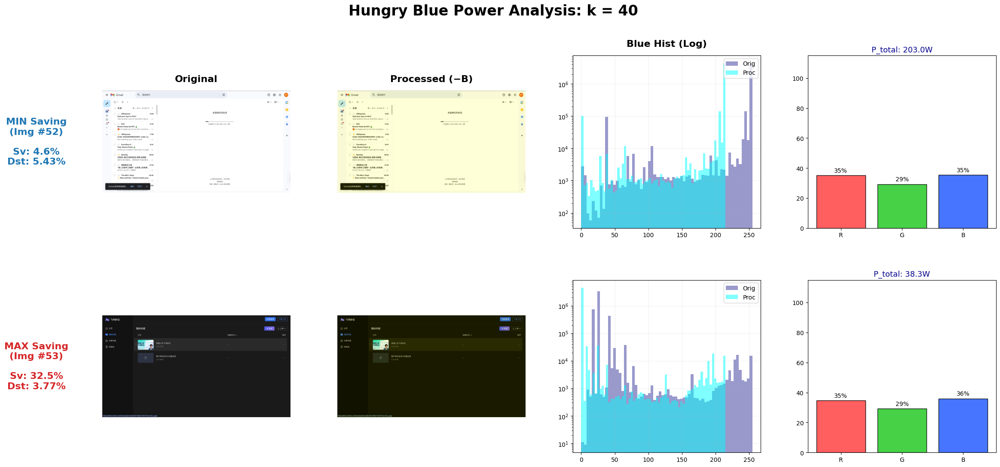

In [55]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import color

# 假设全局变量已定义: W0, W_R, W_G, W_B, GAMMA, all_images, apply_hungry_blue, detailed_data

def get_detailed_power_info(img):
    img_float = img.astype(float)
    p_r = np.sum(W_R * np.power(img_float[:, :, 0], GAMMA))
    p_g = np.sum(W_G * np.power(img_float[:, :, 1], GAMMA))
    p_b = np.sum(W_B * np.power(img_float[:, :, 2], GAMMA))
    dynamic_total = p_r + p_g + p_b
    total_power = W0 + dynamic_total
    ratios = [p_r/dynamic_total*100, p_g/dynamic_total*100, p_b/dynamic_total*100]
    return total_power, ratios

def plot_power_saving_analysis(k, stats):
    # 筛选极值
    min_saving = min(stats, key=lambda x: x['saving'])
    max_saving = max(stats, key=lambda x: x['saving'])
    cases = [('MIN Saving', min_saving, '#1f77b4'), ('MAX Saving', max_saving, '#d62728')]

    fig, axes = plt.subplots(2, 4, figsize=(26, 12))
    fig.suptitle(f'Hungry Blue Power Analysis: k = {k}', fontsize=24, fontweight='bold', y=0.98)

    col_titles = ['Original', 'Processed (−B)', 'Blue Hist (Log)', 'RGB Power Breakdown']
    for ci, ct in enumerate(col_titles):
        axes[0, ci].set_title(ct, fontsize=16, fontweight='bold', pad=15)

    for row, (label, stat, color_code) in enumerate(cases):
        idx = stat['idx']
        img_orig = all_images[idx]
        img_proc = apply_hungry_blue(img_orig, k)

        # 左侧大标签
        ax_label = axes[row, 0]
        label_str = f"{label}\n(Img #{idx})\n\nSv: {stat['saving']:.1f}%\nDst: {stat['dist']:.2f}%"
        ax_label.text(-0.35, 0.5, label_str, transform=ax_label.transAxes, 
                      fontsize=16, fontweight='bold', color=color_code, ha='center', va='center')

        # 1. 原图
        axes[row, 0].imshow(img_orig)
        axes[row, 0].axis('off')

        # 2. 处理图
        axes[row, 1].imshow(img_proc)
        axes[row, 1].axis('off')

        # 3. 蓝色通道直方图 (解释：是否有蓝色像素被削减？)
        axes[row, 2].hist(img_orig[:,:,2].flatten(), bins=64, color='navy', alpha=0.4, label='Orig')
        axes[row, 2].hist(img_proc[:,:,2].flatten(), bins=64, color='cyan', alpha=0.5, label='Proc')
        axes[row, 2].set_yscale('log')
        axes[row, 2].legend(loc='upper right')
        axes[row, 2].grid(alpha=0.2)

        # 4. RGB 功耗占比 (解释：蓝色占总功耗的多少？)
        total_p, ratios = get_detailed_power_info(img_orig)
        bars = axes[row, 3].bar(['R', 'G', 'B'], ratios, color=['#ff4d4d', '#33cc33', '#3366ff'], alpha=0.9, edgecolor='black')
        axes[row, 3].set_ylim(0, 115)
        # 明确标注这是 P_total (Original)
        axes[row, 3].set_title(f"P_total: {total_p:.1f}W", fontsize=13, color='darkblue')
        
        for bar in bars:
            axes[row, 3].text(bar.get_x()+bar.get_width()/2, bar.get_height()+2, f"{bar.get_height():.0f}%", ha='center')

    plt.subplots_adjust(left=0.15, right=0.95, wspace=0.25, hspace=0.3)
    plt.show()

# 执行
if 40 in detailed_data:
    plot_power_saving_analysis(40, detailed_data[40])

In [27]:
def apply_contrast_brightness(img, scale_v):
    # 转换到 HSV (skimage返回 0-1 float)
    hsv = color.rgb2hsv(img)
    hsv[:, :, 2] = hsv[:, :, 2] * scale_v # 调整 V 通道
    hsv[:, :, 2] = np.clip(hsv[:, :, 2], 0, 1) # 限制在 0-1
    # 转回 RGB 并扩展到 0-255
    return (color.hsv2rgb(hsv) * 255).astype(np.uint8)

In [62]:
#strategy 2: Brightness Scaling 
#table 50 natural images or total images
import numpy as np
import pandas as pd

# 存储用于画 Pareto 曲线的平均值
results_contrast = []
# 存储详细数据用于生成统计表和查找代表性图片
detailed_data_contrast = {}

c_values = [1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1] 

print("正在运行 Strategy 2: Brightness Scaling (详细统计版)...")

for c in c_values:
    current_c_stats = []
    
    for idx, img in enumerate(all_images):
        p_orig = estimate_power_part1(img)
        img_new = apply_contrast_brightness(img, c)
        p_new = estimate_power_part1(img_new)
        
        if p_orig > 0:
            saving = (p_orig - p_new) / p_orig * 100
        else:
            saving = 0
            
        dist = compute_distortion(img, img_new)
        
        # 保存单张图片结果
        current_c_stats.append({
            "idx": idx,
            "saving": saving,
            "dist": dist
        })
        
    # 计算平均值 (用于画图)
    all_savings = [x['saving'] for x in current_c_stats]
    all_dists = [x['dist'] for x in current_c_stats]
    
    results_contrast.append((np.mean(all_dists), np.mean(all_savings)))
    
    # 保存详细数据到字典
    detailed_data_contrast[c] = current_c_stats

print("Strategy 2 计算完成！")

# --- 展示 Strategy 2 的统计表 ---
stats_list_cont = []
for c, stats in detailed_data_contrast.items():
    savings = [s['saving'] for s in stats]
    dists = [s['dist'] for s in stats]
    stats_list_cont.append({
        "Parameter (c)": c,
        "Avg Saving %": np.mean(savings),
        "Min Saving %": np.min(savings), # 作业要求的 Min
        "Max Saving %": np.max(savings), # 作业要求的 Max
        "Avg Distortion": np.mean(dists),
        "Min Distortion": np.min(dists),
        "Max Distortion": np.max(dists)
    })

print("\n--- Summary Table for Brightness Scaling ---")
display(pd.DataFrame(stats_list_cont).round(2))

正在运行 Strategy 2: Brightness Scaling (详细统计版)...


/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: divide by zero encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)
/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: overflow encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)
/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: invalid value encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)


Strategy 2 计算完成！

--- Summary Table for Brightness Scaling ---


,Parameter (c),Avg Saving %,Min Saving %,Max Saving %,Avg Distortion,Min Distortion,Max Distortion
0,1.0,0.14,0.00,0.38,0.06,0.00,0.10
1,0.9,8.25,8.00,8.99,1.36,0.43,2.35
2,0.8,16.27,15.92,17.94,2.70,0.83,4.67
3,0.7,24.63,24.33,25.59,4.08,1.12,7.12
4,0.6,33.17,32.75,34.56,5.48,1.46,9.55
5,0.5,41.91,41.63,42.55,6.91,1.71,12.14
6,0.4,51.29,50.90,52.22,8.40,2.01,14.74
7,0.3,61.24,60.91,63.27,9.96,2.28,17.55
8,0.2,71.78,71.34,72.45,11.54,2.49,20.42
9,0.1,83.90,83.47,86.08,13.05,2.75,23.64


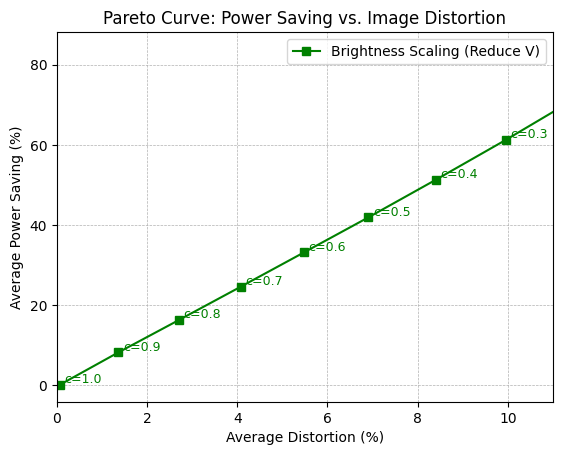

In [29]:
x_cont = [r[0] for r in results_contrast]
y_cont = [r[1] for r in results_contrast]
plt.plot(x_cont, y_cont, 'g-s', label='Brightness Scaling (Reduce V)')
for x, y, c in zip(x_cont, y_cont, c_values):
    if x < 10:
        # y+0.5 让文字稍微还在点上方
        plt.text(x + 0.1, y + 0.5, f'c={c:.1f}', color='green', fontsize=9)
plt.title('Pareto Curve: Power Saving vs. Image Distortion')
plt.xlabel('Average Distortion (%)')
plt.ylabel('Average Power Saving (%)')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.xlim(0, 11) 
    
plt.show()

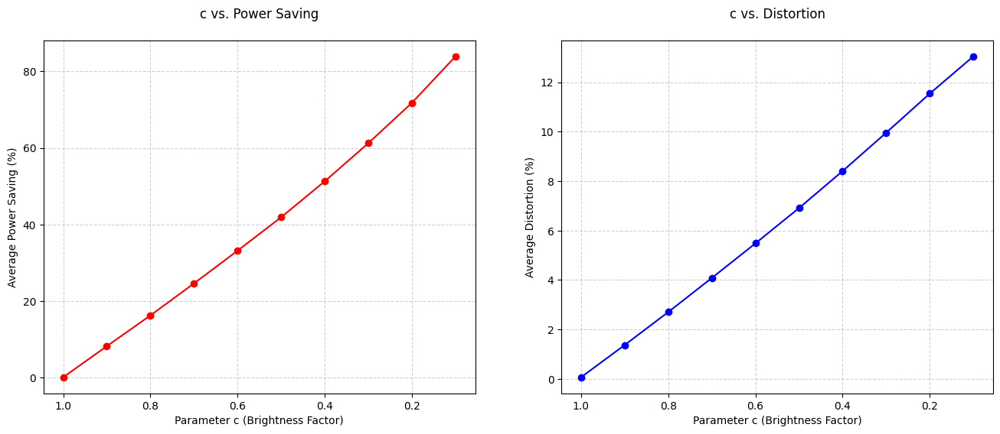

In [30]:
# 提取数据
c_vals = [r['Parameter (c)'] for r in stats_list_cont]
avg_savings = [r['Avg Saving %'] for r in stats_list_cont]
avg_dists = [r['Avg Distortion'] for r in stats_list_cont]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# 图 1: c vs Saving (揭示 Gamma 效应)
ax1.plot(c_vals, avg_savings, 'ro-', label='Saving')
ax1.set_xlabel('Parameter c (Brightness Factor)')
ax1.set_ylabel('Average Power Saving (%)')
ax1.set_title('c vs. Power Saving\n')
ax1.invert_xaxis() # 让 c 从 1.0 到 0.1 显示
ax1.grid(True, linestyle='--', alpha=0.6)

# 图 2: c vs Distortion (揭示 Lab 空间非线性)
ax2.plot(c_vals, avg_dists, 'bo-', label='Distortion')
ax2.set_xlabel('Parameter c (Brightness Factor)')
ax2.set_ylabel('Average Distortion (%)')
ax2.set_title('c vs. Distortion\n')
ax2.invert_xaxis()
ax2.grid(True, linestyle='--', alpha=0.6)

plt.show()

--- 正在分析自然图像组中 Distortion 最大的前 5 张图片 (c=0.7) ---


/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: divide by zero encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)
/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: overflow encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)
/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: invalid value encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)


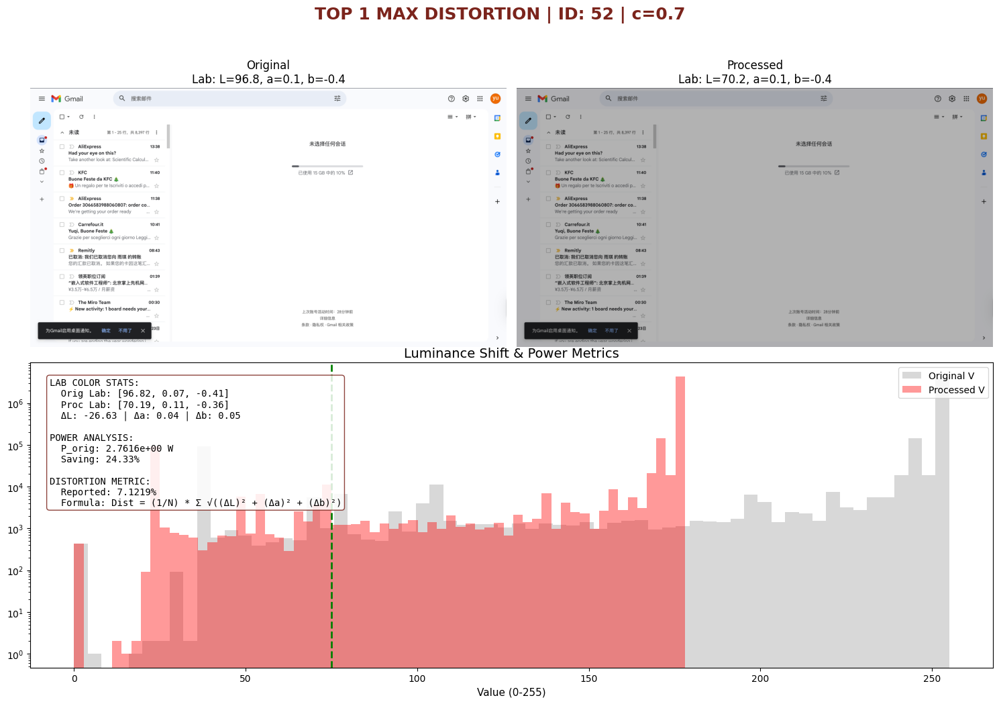

Rank 1: ID 52 - Distortion: 7.1219%
----------------------------------------------------------------------------------------------------


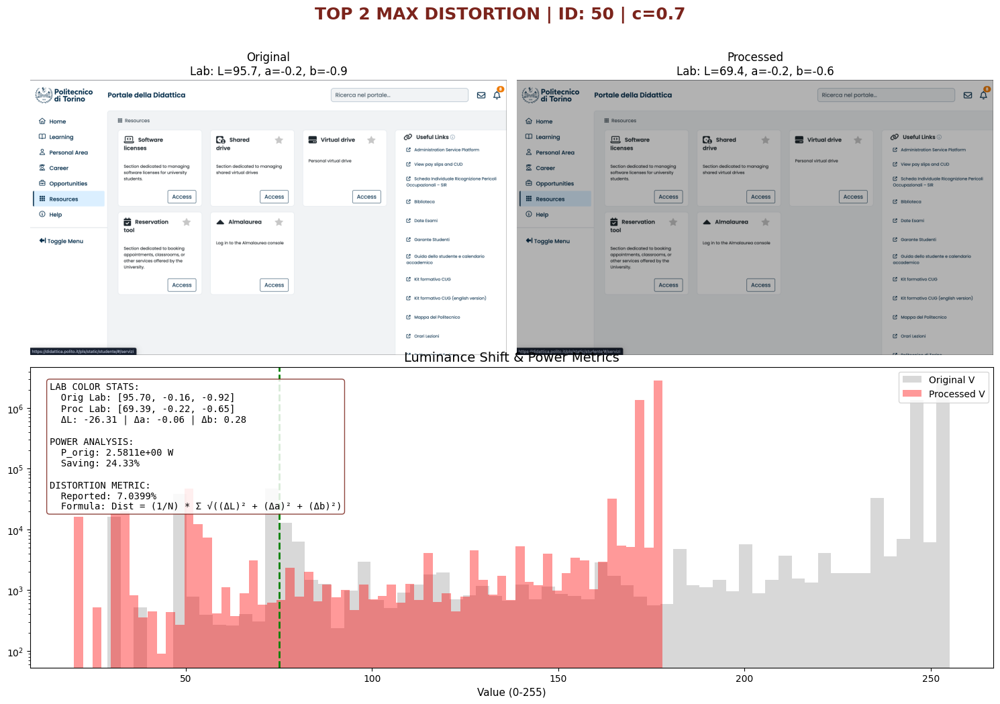

Rank 2: ID 50 - Distortion: 7.0399%
----------------------------------------------------------------------------------------------------


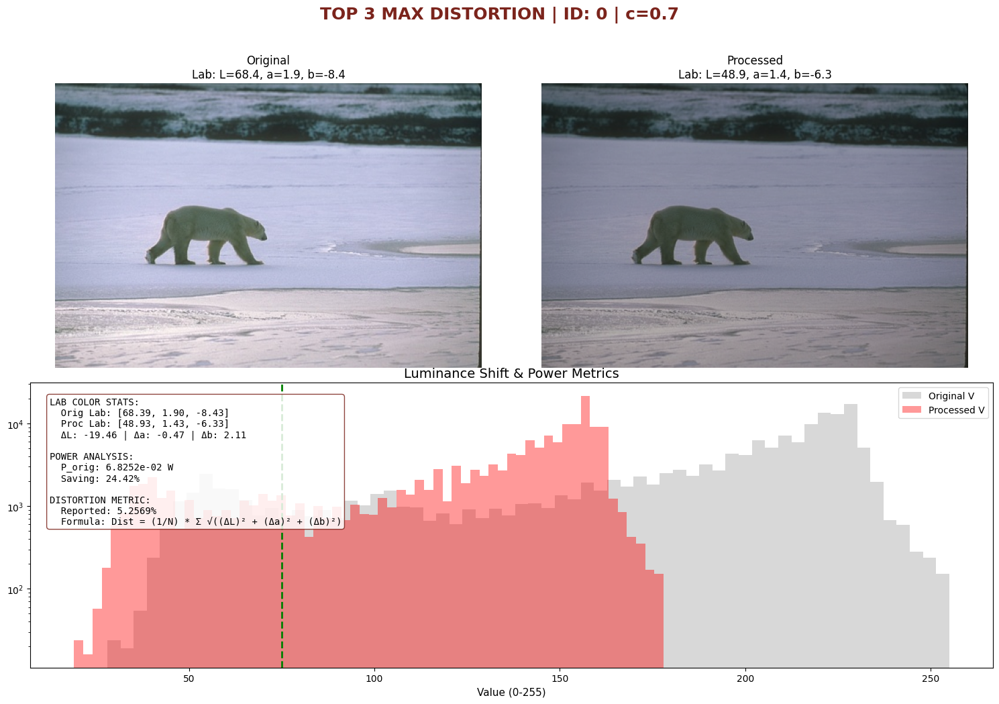

Rank 3: ID 0 - Distortion: 5.2569%
----------------------------------------------------------------------------------------------------


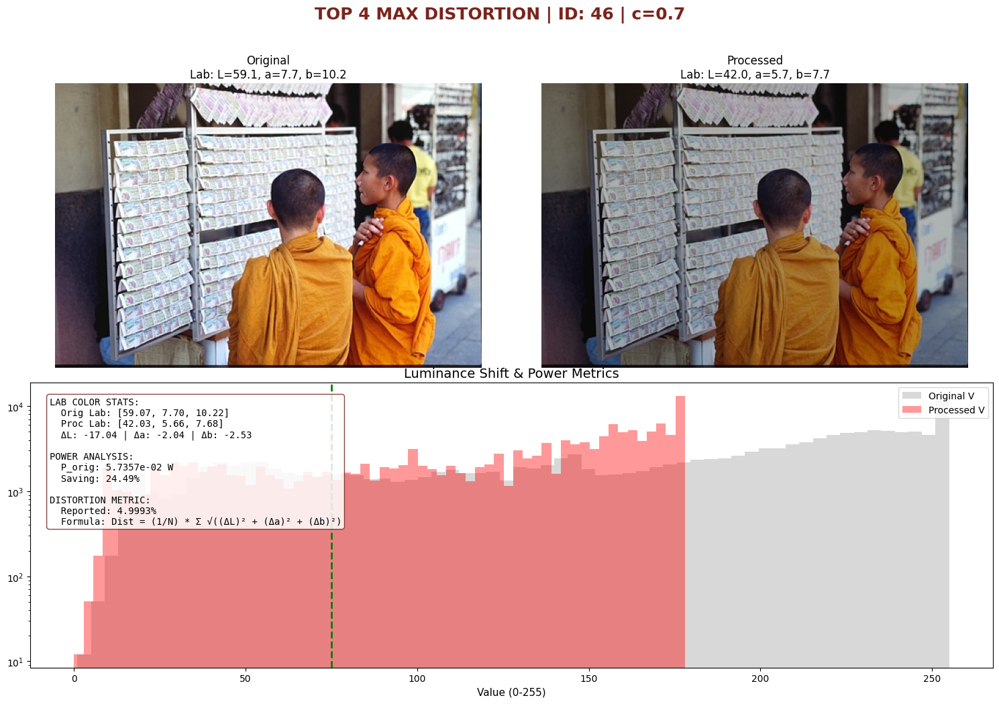

Rank 4: ID 46 - Distortion: 4.9993%
----------------------------------------------------------------------------------------------------


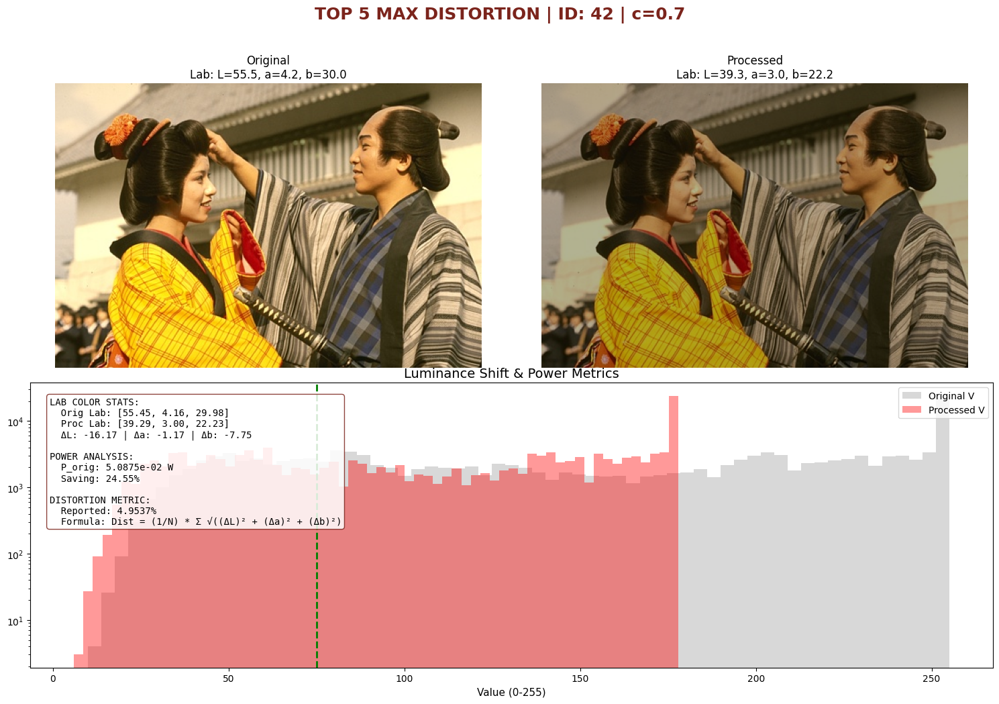

Rank 5: ID 42 - Distortion: 4.9537%
----------------------------------------------------------------------------------------------------


In [31]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import color
from mpl_toolkits.axes_grid1 import make_axes_locatable

# --- 假设已有的功耗模型参数 ---
W0 = 1.48169521e-6
GAMMA = 0.7755
W_R, W_G, W_B = 2.13636845e-7, 1.77746705e-7, 2.14348309e-7

def get_power_val(img):
    """计算单张图片的功耗数值"""
    img_f = img.astype(np.float64) / 255.0 # 归一化到0-1进行幂运算
    p_dyn = np.sum(W_R * np.power(img_f[:, :, 0], GAMMA) + 
                   W_G * np.power(img_f[:, :, 1], GAMMA) + 
                   W_B * np.power(img_f[:, :, 2], GAMMA))
    return p_dyn + W0

def plot_top_distortion_analysis(target_c, group_indices):
    """
    专门分析指定范围内 Distortion 最大的前5张图片
    """
    # 1. 筛选并排序
    all_stats = detailed_data_contrast[target_c]
    # 过滤出自然图像组的数据
    group_stats = [item for item in all_stats if item['idx'] in group_indices]
    
    # 按 distortion 降序排列，取前5个
    top_5_distortion = sorted(group_stats, key=lambda x: x['dist'], reverse=True)[:5]

    if not top_5_distortion:
        print("未找到符合条件的数据")
        return

    print(f"--- 正在分析自然图像组中 Distortion 最大的前 5 张图片 (c={target_c}) ---")

    for rank, rec in enumerate(top_5_distortion):
        idx = rec['idx']
        orig = all_images[idx]
        proc = apply_contrast_brightness(orig, target_c)
        
        # --- 数据计算 ---
        p_orig = get_power_val(orig)
        p_proc = get_power_val(proc)
        
        # --- CIELAB 空间分析 ---
        # 转换到 Lab 空间 (skimage 期望 0-1 或 uint8)
        lab_orig = color.rgb2lab(orig)
        lab_proc = color.rgb2lab(proc)
        
        # 计算平均 Lab 值
        avg_lab_o = np.mean(lab_orig, axis=(0, 1))
        avg_lab_p = np.mean(lab_proc, axis=(0, 1))
        
        # 亮度分布 (V channel)
        v_orig = color.rgb2hsv(orig)[:,:,2] * 255
        v_proc = color.rgb2hsv(proc)[:,:,2] * 255
        dark_threshold = 75
        dark_ratio = (np.sum(v_orig < dark_threshold) / v_orig.size) * 100

        # --- 绘图布局 ---
        fig = plt.figure(figsize=(15, 11))
        fig.suptitle(f"TOP {rank+1} MAX DISTORTION | ID: {idx} | c={target_c}", 
                     fontsize=18, fontweight='bold', color='#7b241c', y=0.98)

        # (Top Left) 原图
        ax1 = plt.subplot(2, 2, 1)
        ax1.imshow(orig)
        ax1.set_title(f"Original\nLab: L={avg_lab_o[0]:.1f}, a={avg_lab_o[1]:.1f}, b={avg_lab_o[2]:.1f}", fontsize=12)
        ax1.axis('off')

        # (Top Right) 处理图
        ax2 = plt.subplot(2, 2, 2)
        ax2.imshow(proc)
        ax2.set_title(f"Processed\nLab: L={avg_lab_p[0]:.1f}, a={avg_lab_p[1]:.1f}, b={avg_lab_p[2]:.1f}", fontsize=12)
        ax2.axis('off')

        # (Bottom Row) 亮度分布直方图
        ax_hist = plt.subplot(2, 1, 2)
        ax_hist.hist(v_orig.flatten(), bins=64, color='gray', alpha=0.3, label='Original V')
        ax_hist.hist(v_proc.flatten(), bins=64, color='red', alpha=0.4, label='Processed V')
        ax_hist.axvline(dark_threshold, color='green', linestyle='--', lw=2)
        ax_hist.set_title(f"Luminance Shift & Power Metrics", fontsize=14)
        ax_hist.set_xlabel("Value (0-255)", fontsize=11)
        ax_hist.set_yscale('log')
        ax_hist.legend(loc='upper right')

        # --- 添加详细数据框 ---
        # 包含 Lab 值对比和公式
        stats_text = (
            f"LAB COLOR STATS:\n"
            f"  Orig Lab: [{avg_lab_o[0]:.2f}, {avg_lab_o[1]:.2f}, {avg_lab_o[2]:.2f}]\n"
            f"  Proc Lab: [{avg_lab_p[0]:.2f}, {avg_lab_p[1]:.2f}, {avg_lab_p[2]:.2f}]\n"
            f"  ΔL: {avg_lab_p[0]-avg_lab_o[0]:.2f} | Δa: {avg_lab_p[1]-avg_lab_o[1]:.2f} | Δb: {avg_lab_p[2]-avg_lab_o[2]:.2f}\n\n"
            f"POWER ANALYSIS:\n"
            f"  P_orig: {p_orig:.4e} W\n"
            f"  Saving: {rec['saving']:.2f}%\n\n"
            f"DISTORTION METRIC:\n"
            f"  Reported: {rec['dist']:.4f}%\n"
            f"  Formula: Dist = (1/N) * Σ √((ΔL)² + (Δa)² + (Δb)²)"
        )
        
        # 将文本放在直方图左侧或下方
        ax_hist.text(0.02, 0.95, stats_text, transform=ax_hist.transAxes, 
                     fontsize=10, family='monospace', verticalalignment='top',
                     bbox=dict(boxstyle='round', facecolor='white', alpha=0.85, edgecolor='#7b241c'))

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()
        print(f"Rank {rank+1}: ID {idx} - Distortion: {rec['dist']:.4f}%")
        print("-" * 100)

        

# --- 执行 ---
TARGET_C = 0.7
# 自然图像组通常是 0-49
NATURAL_INDICES = range(0, 55) 

plot_top_distortion_analysis(TARGET_C, NATURAL_INDICES)

就是说大部分图像的l都分布在30-70，而a，b大部分值都在-10～30，

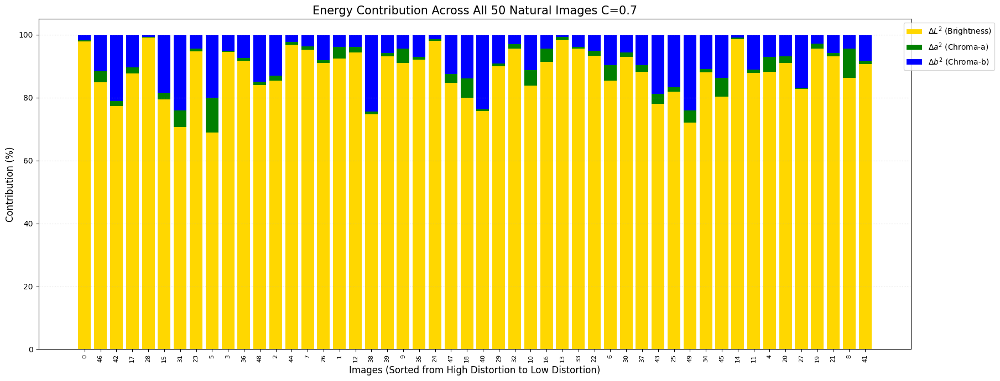

In [32]:
def plot_full_set_energy_breakdown(target_c, group_indices, images):
    """
    分析全部 50 张图片的能量拆解，并按失真大小排序
    """
    results = []
    for idx in group_indices:
        orig = images[idx]
        proc = apply_contrast_brightness(orig, target_c)
        lab_o, lab_p = color.rgb2lab(orig), color.rgb2lab(proc)
        
        diff_sq = (lab_o - lab_p)**2
        msd_l, msd_a, msd_b = np.mean(diff_sq[:,:,0]), np.mean(diff_sq[:,:,1]), np.mean(diff_sq[:,:,2])
        total_msd = msd_l + msd_a + msd_b
        
        results.append({
            'idx': idx,
            'total_dist': np.sqrt(total_msd),
            'l_pct': msd_l / total_msd * 100,
            'a_pct': msd_a / total_msd * 100,
            'b_pct': msd_b / total_msd * 100
        })

    # 按失真总值从大到小排序，这样可以看到趋势
    results_sorted = sorted(results, key=lambda x: x['total_dist'], reverse=True)

    # 绘图
    plt.figure(figsize=(18, 7))
    indices = np.arange(len(results_sorted))
    l_vals = [r['l_pct'] for r in results_sorted]
    a_vals = [r['a_pct'] for r in results_sorted]
    b_vals = [r['b_pct'] for r in results_sorted]
    
    plt.bar(indices, l_vals, color='gold', label='$\Delta L^2$ (Brightness)')
    plt.bar(indices, a_vals, bottom=l_vals, color='green', label='$\Delta a^2$ (Chroma-a)')
    plt.bar(indices, b_vals, bottom=np.array(l_vals)+np.array(a_vals), color='blue', label='$\Delta b^2$ (Chroma-b)')

    plt.title(f"Energy Contribution Across All 50 Natural Images C=0.7", fontsize=15)
    plt.xlabel("Images (Sorted from High Distortion to Low Distortion)", fontsize=12)
    plt.ylabel("Contribution (%)", fontsize=12)
    plt.xticks(indices, [r['idx'] for r in results_sorted], rotation=90, fontsize=8)
    plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1))
    plt.grid(axis='y', linestyle=':', alpha=0.5)
    plt.tight_layout()
    plt.show()

# 执行
plot_full_set_energy_breakdown(0.7, range(0, 50), all_images)

正在生成 MAX Distortion 对比图...


/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: divide by zero encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)
/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: overflow encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)
/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: invalid value encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)


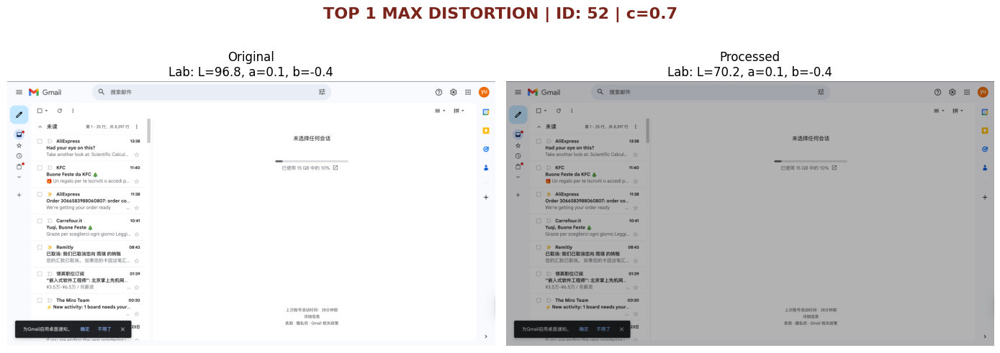

正在生成 MIN Distortion 对比图...


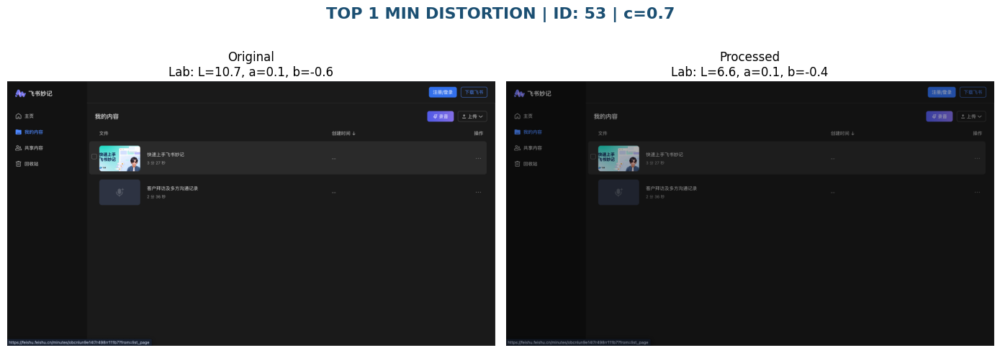

In [33]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import color

def plot_distortion_extremes_images_only(target_c, group_indices, mode="max"):
    """
    分析指定范围内 Distortion 最大或最小的前 1 张图片
    【纯净版】：只显示图片对比，不显示直方图，不显示文字框
    """
    # 1. 筛选数据
    # 假设 detailed_data_contrast 和 all_images 已经在上下文中定义
    all_stats = detailed_data_contrast[target_c]
    group_stats = [item for item in all_stats if item['idx'] in group_indices]
    
    # 2. 排序逻辑
    if mode == "max":
        # 降序排列，取最大的前1个
        top_items = sorted(group_stats, key=lambda x: x['dist'], reverse=True)[:1]
        title_prefix = "TOP 1 MAX DISTORTION"
        theme_color = '#7b241c'  # 深红色
    else:
        # 升序排列，取最小的前1个
        top_items = sorted(group_stats, key=lambda x: x['dist'], reverse=False)[:1]
        title_prefix = "TOP 1 MIN DISTORTION"
        theme_color = '#1b4f72'  # 深蓝色

    if not top_items: return

    for rec in top_items:
        idx = rec['idx']
        orig = all_images[idx]
        # 假设 apply_contrast_brightness 已经在上下文中定义
        proc = apply_contrast_brightness(orig, target_c)
        
        # --- 数据计算 (仅用于标题显示) ---
        lab_orig = color.rgb2lab(orig)
        lab_proc = color.rgb2lab(proc)
        
        avg_lab_o = np.mean(lab_orig, axis=(0, 1))
        avg_lab_p = np.mean(lab_proc, axis=(0, 1))

        # --- 绘图布局 (修改为 1行2列，只放图片) ---
        fig, axes = plt.subplots(1, 2, figsize=(14, 6)) # 调整画布大小，变矮一点
        
        # 总标题
        fig.suptitle(f"{title_prefix} | ID: {idx} | c={target_c}", 
                     fontsize=16, fontweight='bold', color=theme_color, y=0.95)

        # 1. 左图：原图
        axes[0].imshow(orig)
        axes[0].set_title(f"Original\nLab: L={avg_lab_o[0]:.1f}, a={avg_lab_o[1]:.1f}, b={avg_lab_o[2]:.1f}", fontsize=12)
        axes[0].axis('off')

        # 2. 右图：处理图
        axes[1].imshow(proc)
        axes[1].set_title(f"Processed\nLab: L={avg_lab_p[0]:.1f}, a={avg_lab_p[1]:.1f}, b={avg_lab_p[2]:.1f}", fontsize=12)
        axes[1].axis('off')

        plt.tight_layout()
        plt.show()

# --- 执行代码 ---
TARGET_C = 0.7
NATURAL_INDICES = range(0, 55)

# 1. 运行最大失真 (MAX) -> 只有两张图并排
print("正在生成 MAX Distortion 对比图...")
plot_distortion_extremes_images_only(TARGET_C, NATURAL_INDICES, mode="max")

# 2. 运行最小失真 (MIN) -> 只有两张图并排
print("正在生成 MIN Distortion 对比图...")
plot_distortion_extremes_images_only(TARGET_C, NATURAL_INDICES, mode="min")

正在生成 L 的详细计算过程图...


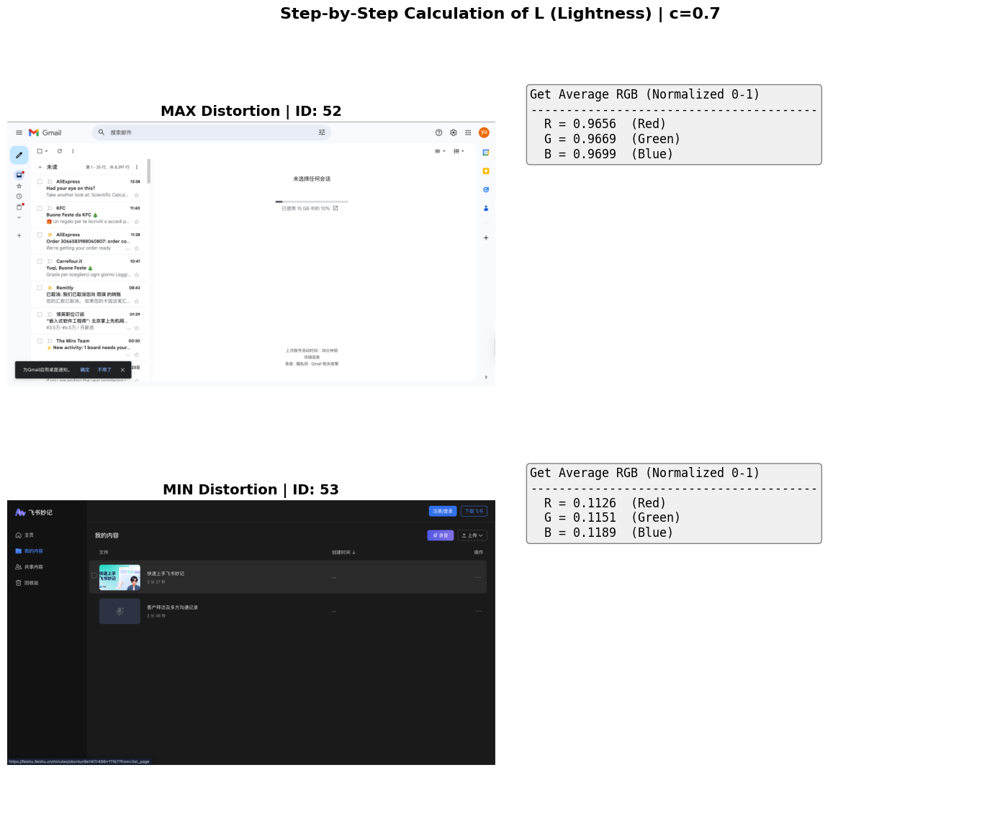

In [34]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import color

def show_L_calculation_process(target_c, group_indices):
    """
    展示 Max 和 Min 图片的 RGB -> Y -> L 的详细计算过程
    """
    # 1. 获取数据
    all_stats = detailed_data_contrast[target_c]
    group_stats = [item for item in all_stats if item['idx'] in group_indices]
    
    # 找出 Max (Rank 1) 和 Min (Rank 1)
    max_item = sorted(group_stats, key=lambda x: x['dist'], reverse=True)[0]
    min_item = sorted(group_stats, key=lambda x: x['dist'], reverse=False)[0]
    
    extremes = [("MAX Distortion", max_item), 
                ("MIN Distortion", min_item)]

    # 2. 绘图
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))
    fig.suptitle(f"Step-by-Step Calculation of L (Lightness) | c={target_c}", fontsize=16, fontweight='bold')

    for i, (title, item) in enumerate(extremes):
        idx = item['idx']
        orig = all_images[idx]
        
        # --- A. 准备数据 ---
        # 1. 算出整张图的平均 RGB (0-1范围)
        avg_rgb_255 = np.mean(orig, axis=(0, 1))
        r, g, b = avg_rgb_255 / 255.0  # 归一化到 0-1
        
        # 2. 使用 skimage 算出标准的 XYZ 和 Lab (作为标准答案)
        # 我们创建一个只有1个像素的假图像来通过 skimage 计算，保证精准
        pixel_array = np.array([[[r, g, b]]], dtype=np.float64) # shape (1,1,3)
        xyz_vals = color.rgb2xyz(pixel_array)[0,0] # [X, Y, Z]
        lab_vals = color.rgb2lab(pixel_array)[0,0] # [L, a, b]
        
        Y_true = xyz_vals[1] # 提取 Y (Luminance)
        L_true = lab_vals[0] # 提取 L (Lightness)

        # --- B. 左侧：图片展示 ---
        ax_img = axes[i, 0]
        ax_img.imshow(orig)
        ax_img.set_title(f"{title} | ID: {idx}", fontsize=14, fontweight='bold')
        ax_img.axis('off')

        # --- C. 右侧：计算过程黑板 ---
        ax_text = axes[i, 1]
        ax_text.axis('off')
        
        # 构造显示的文本 (类似于数学解题步骤)
        # 注意：这里为了展示逻辑，显示的是线性变换的核心概念
        calc_text = (
            f"Get Average RGB (Normalized 0-1)\n"
            f"----------------------------------------\n"
            f"  R = {r:.4f}  (Red)\n"
            f"  G = {g:.4f}  (Green)\n"
            f"  B = {b:.4f}  (Blue)"
        )
        
        # 在图上写字
        ax_text.text(0.05, 0.95, calc_text, transform=ax_text.transAxes, 
                     fontsize=12, family='monospace', verticalalignment='top',
                     bbox=dict(boxstyle='round', facecolor='#f0f0f0', alpha=1, edgecolor='gray'))

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# --- 执行 ---
TARGET_C = 0.7
NATURAL_INDICES = range(0, 55)

print("正在生成 L 的详细计算过程图...")
show_L_calculation_process(TARGET_C, NATURAL_INDICES)

正在生成对齐后的融合分析图 (Target c=0.7)...


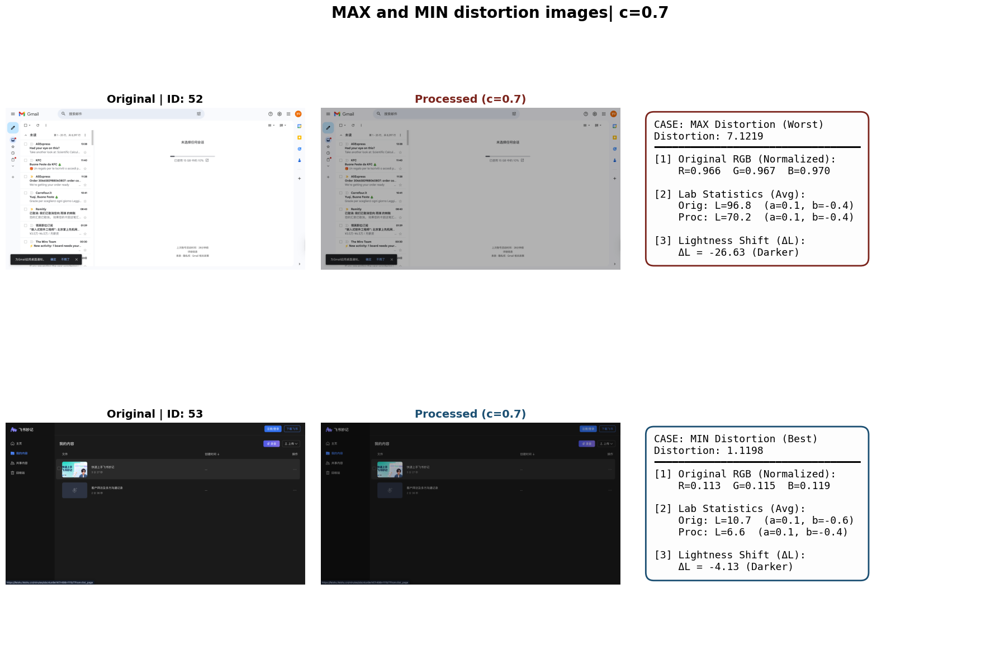

In [35]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import color

def pad_image_to_center(img, target_h, target_w, bg_color=(1, 1, 1)):
    """
    辅助函数：将图片填充到指定大小 (target_h, target_w)，
    原图居中，背景填充为 bg_color (默认白色)。
    """
    h, w, c = img.shape
    
    # 创建纯色背景画布
    # 假设输入图片是 0-1 float，如果是 0-255 uint8 需调整
    if img.dtype == np.uint8:
        bg_val = [int(c * 255) for c in bg_color]
        canvas = np.full((target_h, target_w, c), bg_val, dtype=np.uint8)
    else:
        canvas = np.full((target_h, target_w, c), bg_color, dtype=np.float64)
    
    # 计算居中位置
    y_off = (target_h - h) // 2
    x_off = (target_w - w) // 2
    
    # 填入原图
    canvas[y_off:y_off+h, x_off:x_off+w, :] = img
    return canvas

def analyze_distortion_aligned(target_c, group_indices):
    """
    对齐优化版：
    1. 计算 Max/Min 数据。
    2. 将图片填充至相同尺寸以保证对齐。
    3. 展示详细数据。
    """
    
    # --- 1. 数据筛选与准备 ---
    all_stats = detailed_data_contrast[target_c]
    group_stats = [item for item in all_stats if item['idx'] in group_indices]
    
    if not group_stats: return

    # 找出 Max 和 Min
    max_item = sorted(group_stats, key=lambda x: x['dist'], reverse=True)[0]
    min_item = sorted(group_stats, key=lambda x: x['dist'], reverse=False)[0]
    
    cases = [
        ("MAX Distortion (Worst)", max_item, '#7b241c'), 
        ("MIN Distortion (Best)",  min_item, '#1b4f72') 
    ]
    
    # --- 2. 预处理：获取统一尺寸以实现完美对齐 ---
    # 先把图取出来
    imgs_data = []
    for _, item, _ in cases:
        idx = item['idx']
        orig = all_images[idx] # 原始图
        # 注意：这里假设 apply_contrast_brightness 返回的尺寸和原图一致
        proc = apply_contrast_brightness(orig, target_c) 
        imgs_data.append({'orig': orig, 'proc': proc, 'idx': idx})

    # 计算最大宽和高
    max_h = max(d['orig'].shape[0] for d in imgs_data)
    max_w = max(d['orig'].shape[1] for d in imgs_data)

    # --- 3. 绘图初始化 ---
    # 使用 width_ratios 控制列宽：图片占1份，文字框占1.2份
    fig, axes = plt.subplots(2, 3, figsize=(18, 12), 
                             gridspec_kw={'width_ratios': [1, 1, 1.2]})
    
    fig.suptitle(f"MAX and MIN distortion images| c={target_c}", 
                 fontsize=20, fontweight='bold', y=0.96)

    for row_idx, (title_prefix, item, theme_color) in enumerate(cases):
        # 取出刚才准备的数据
        current_data = imgs_data[row_idx]
        orig_raw = current_data['orig']
        proc_raw = current_data['proc']
        img_idx = current_data['idx']
        distortion_val = item['dist']

        # --- A. 核心数据计算 (必须用原始 raw 图片算，不能用填充后的) ---
        # 1. RGB
        avg_rgb_255 = np.mean(orig_raw, axis=(0, 1))
        r, g, b = avg_rgb_255 / 255.0
        
        # 2. Lab
        lab_orig = color.rgb2lab(orig_raw)
        l_o, a_o, b_o = np.mean(lab_orig, axis=(0, 1))
        
        lab_proc = color.rgb2lab(proc_raw)
        l_p, a_p, b_p = np.mean(lab_proc, axis=(0, 1))
        
        delta_L = l_p - l_o

        # --- B. 视觉对齐处理 (Padding) ---
        # 将图片填充到 max_h, max_w，背景设为白色以便融入底色
        orig_display = pad_image_to_center(orig_raw, max_h, max_w, bg_color=(1,1,1))
        proc_display = pad_image_to_center(proc_raw, max_h, max_w, bg_color=(1,1,1))

        # --- C. 绘图 ---
        
        # [第一列] Original
        ax_orig = axes[row_idx, 0]
        ax_orig.imshow(orig_display)
        ax_orig.set_title(f"Original | ID: {img_idx}", fontsize=14, fontweight='bold')
        ax_orig.axis('off')
        
        # [第二列] Processed
        ax_proc = axes[row_idx, 1]
        ax_proc.imshow(proc_display)
        ax_proc.set_title(f"Processed (c={target_c})", fontsize=14, fontweight='bold', color=theme_color)
        ax_proc.axis('off')
        
        # [第三列] Info Board
        ax_text = axes[row_idx, 2]
        ax_text.axis('off')
        
        info_text = (
            f"CASE: {title_prefix}\n"
            f"Distortion: {distortion_val:.4f}\n"
            f"━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━\n"
            f"[1] Original RGB (Normalized):\n"
            f"    R={r:.3f}  G={g:.3f}  B={b:.3f}\n\n"
            
            f"[2] Lab Statistics (Avg):\n"
            f"    Orig: L={l_o:.1f}  (a={a_o:.1f}, b={b_o:.1f})\n"
            f"    Proc: L={l_p:.1f}  (a={a_p:.1f}, b={b_p:.1f})\n\n"
            
            f"[3] Lightness Shift (ΔL):\n"
            f"    ΔL = {delta_L:+.2f} ({'Brighter' if delta_L>0 else 'Darker'})"
        )
        
        # 垂直居中对齐文本框 (valign='center')
        ax_text.text(0.05, 0.5, info_text, transform=ax_text.transAxes, 
                     fontsize=13, family='monospace', verticalalignment='center',
                     bbox=dict(boxstyle='round,pad=0.8', facecolor='#fdfdfd', 
                               edgecolor=theme_color, linewidth=2))

    # 调整子图间距
    plt.tight_layout(rect=[0, 0, 1, 0.94])
    # 稍微增加行间距，防止两行太挤
    plt.subplots_adjust(hspace=0.15, wspace=0.05)
    plt.show()

# --- 执行 ---
TARGET_C = 0.7
NATURAL_INDICES = range(0, len(all_images))

print(f"正在生成对齐后的融合分析图 (Target c={TARGET_C})...")
analyze_distortion_aligned(TARGET_C, NATURAL_INDICES)

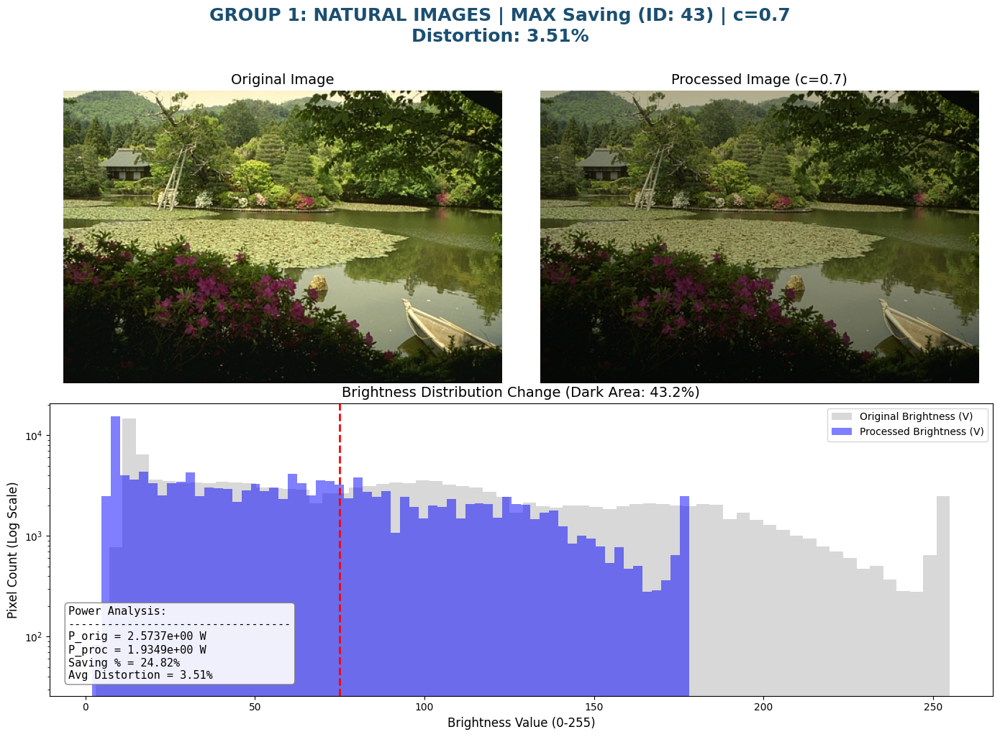

--------------------------------------------------------------------------------------------------------------


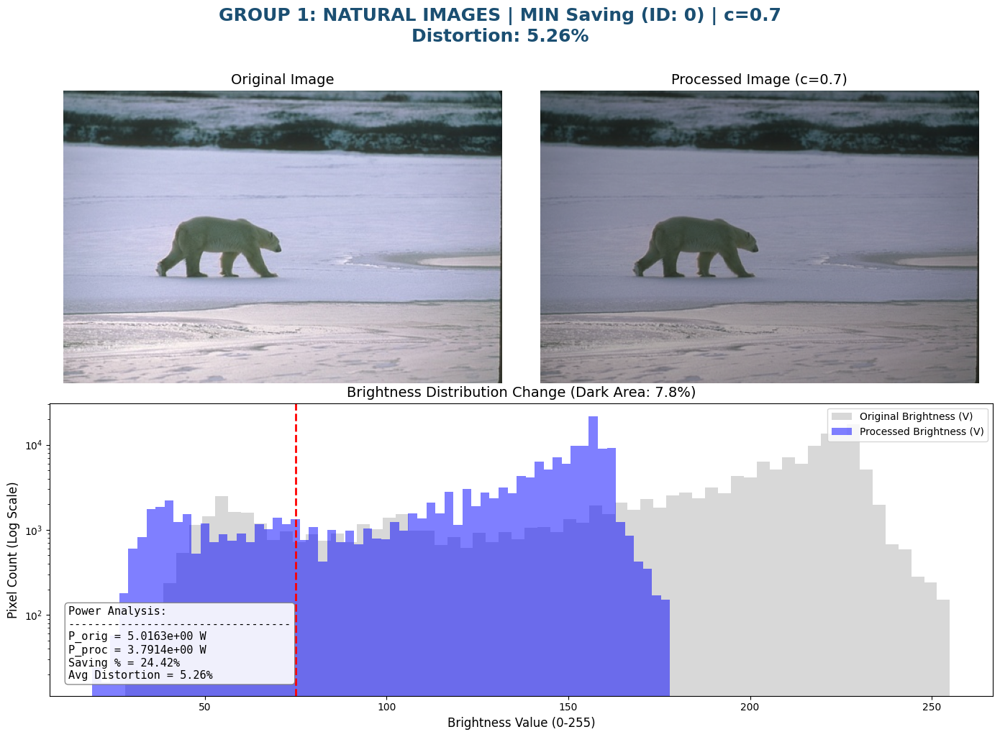

--------------------------------------------------------------------------------------------------------------


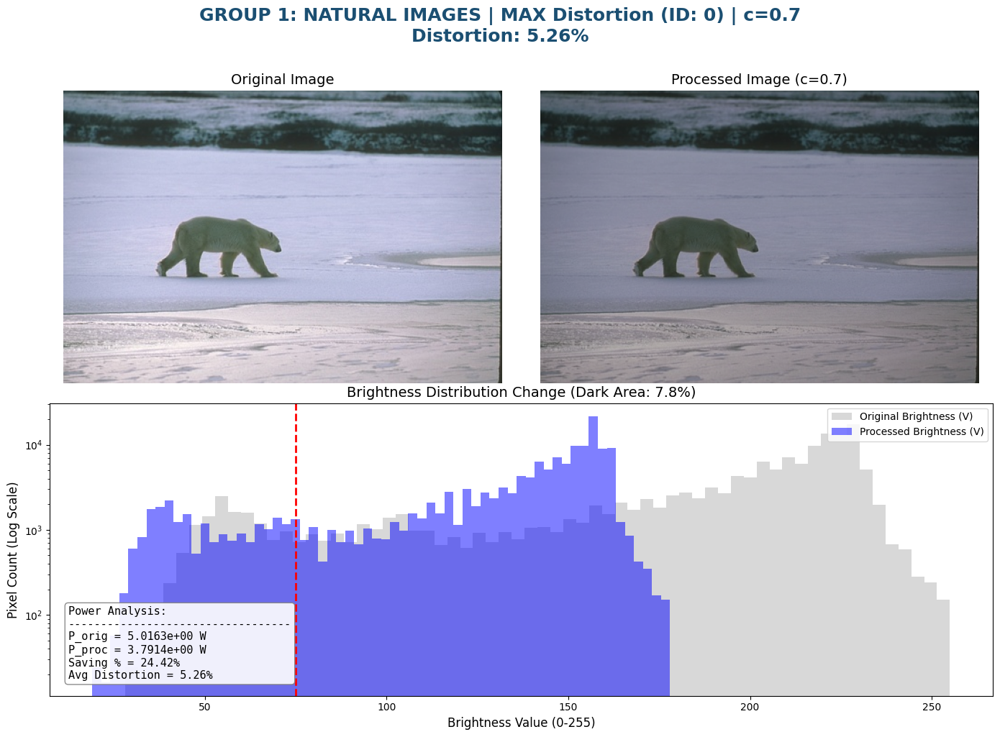

--------------------------------------------------------------------------------------------------------------


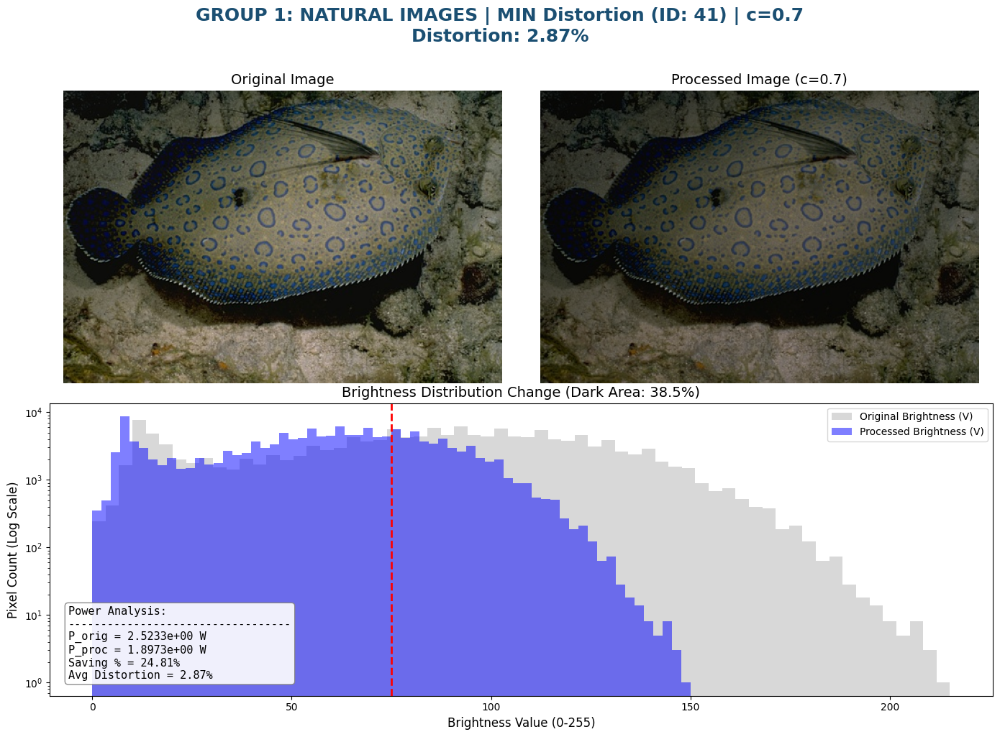

--------------------------------------------------------------------------------------------------------------


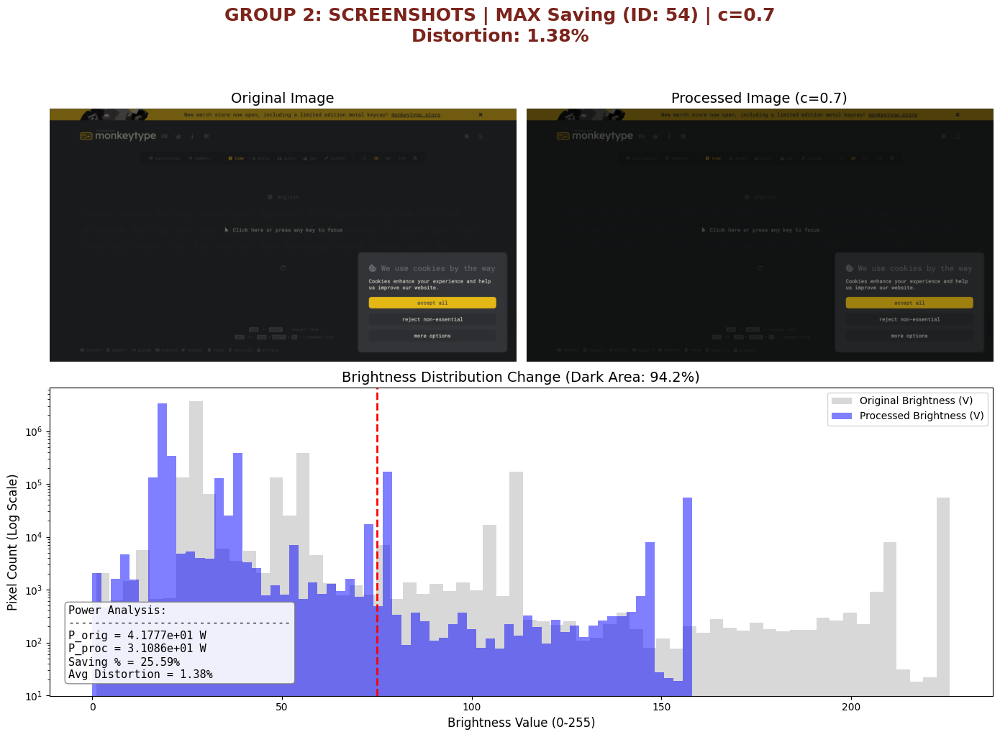

--------------------------------------------------------------------------------------------------------------


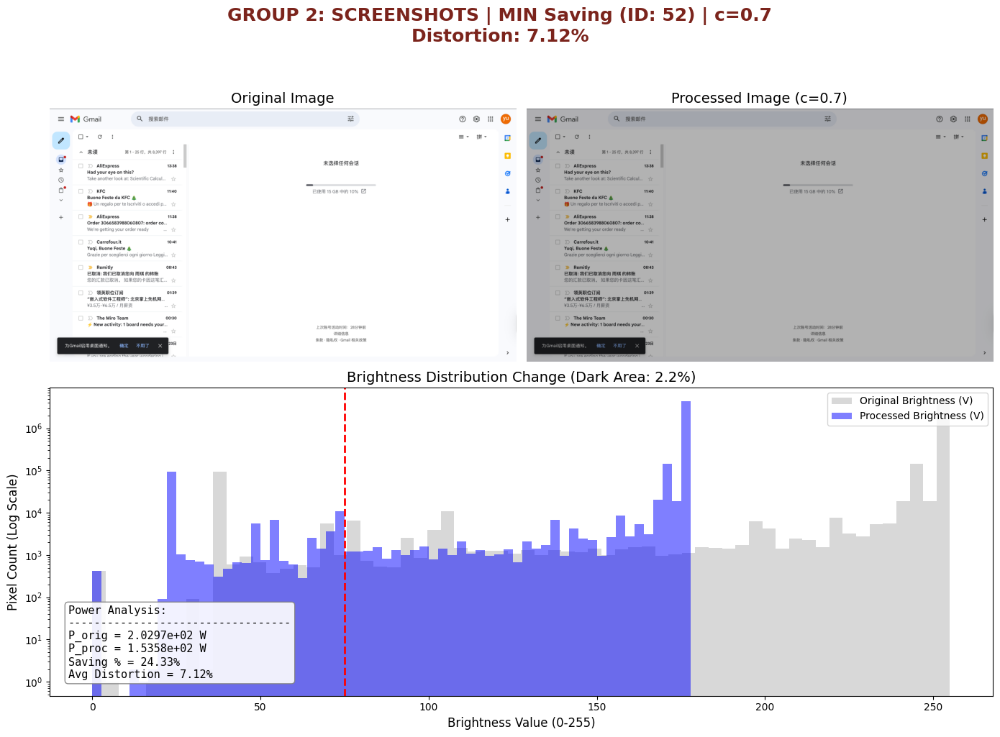

--------------------------------------------------------------------------------------------------------------


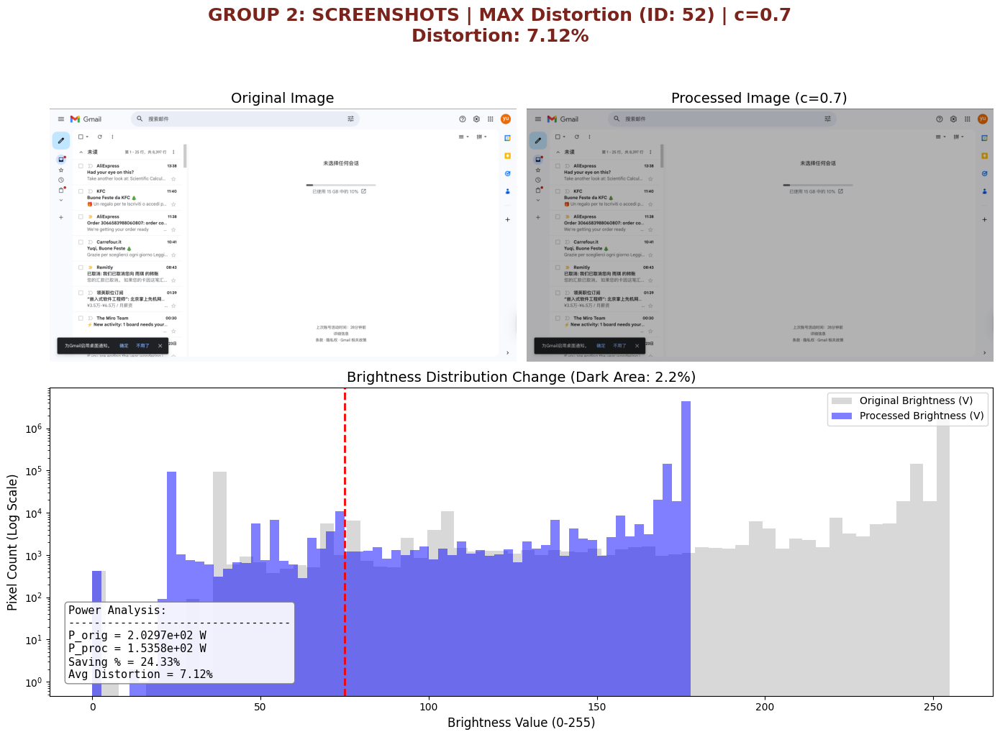

--------------------------------------------------------------------------------------------------------------


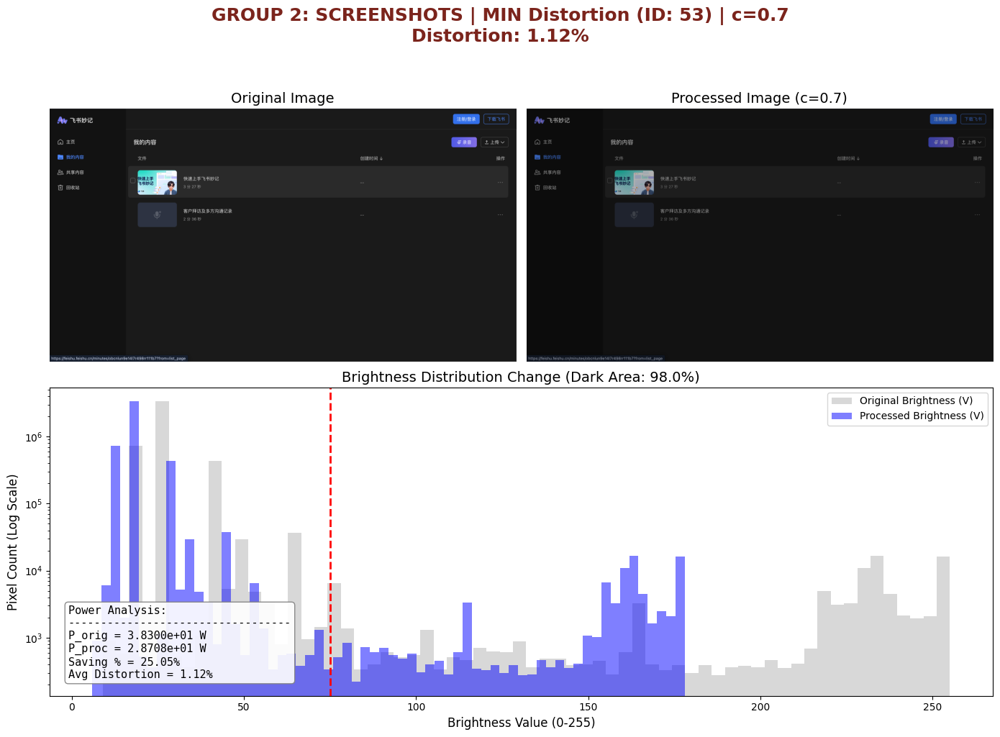

--------------------------------------------------------------------------------------------------------------


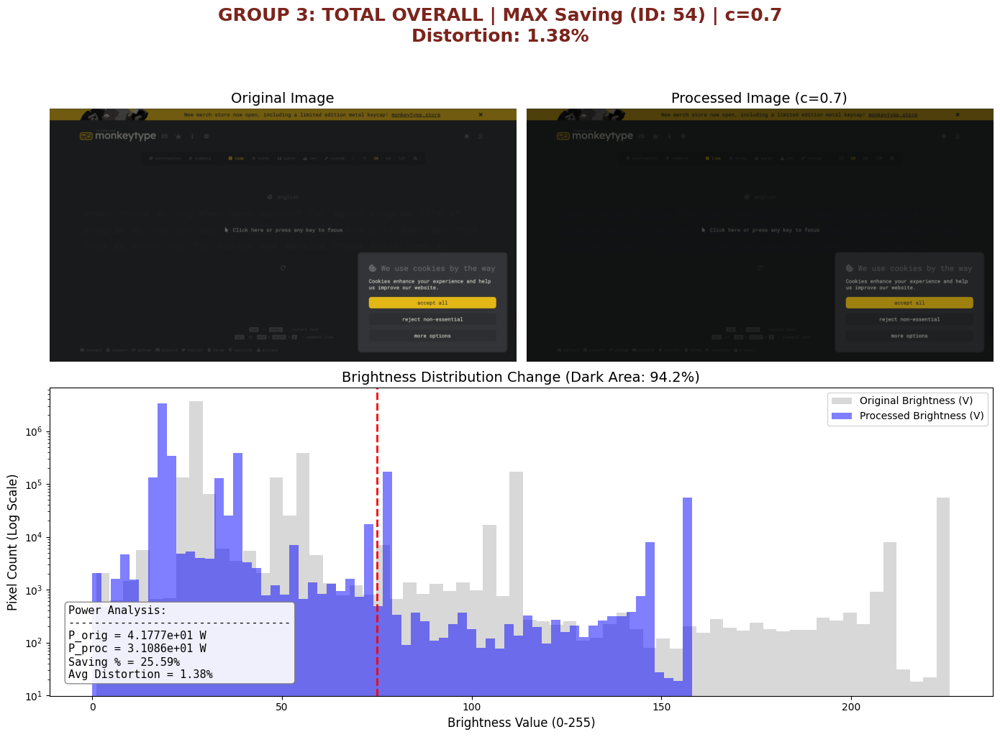

--------------------------------------------------------------------------------------------------------------


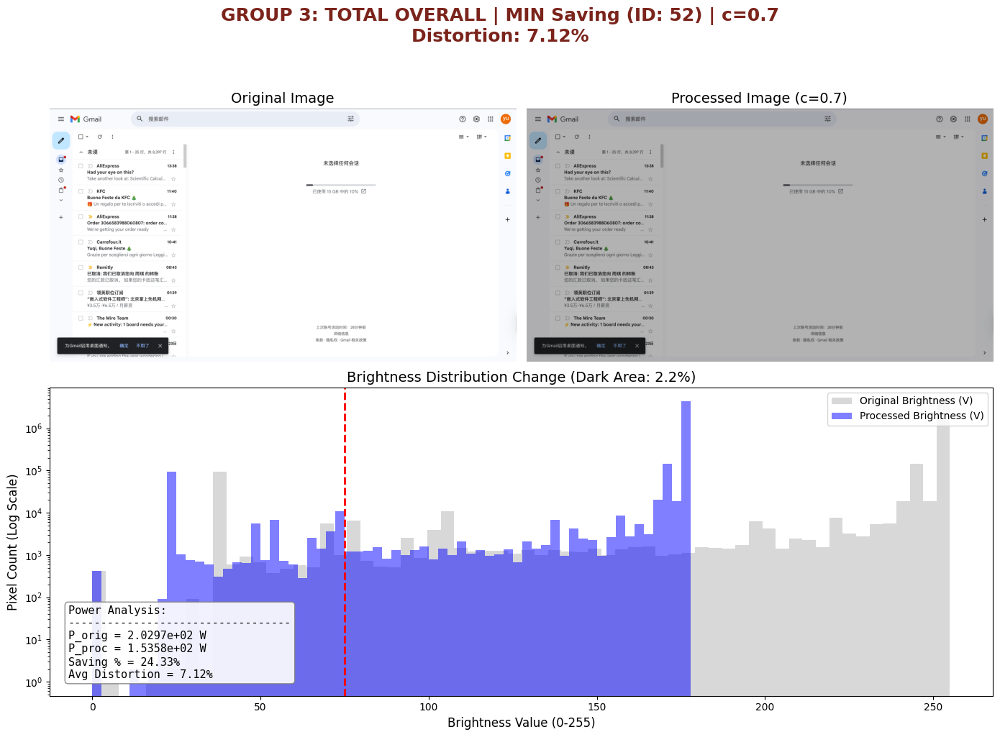

--------------------------------------------------------------------------------------------------------------


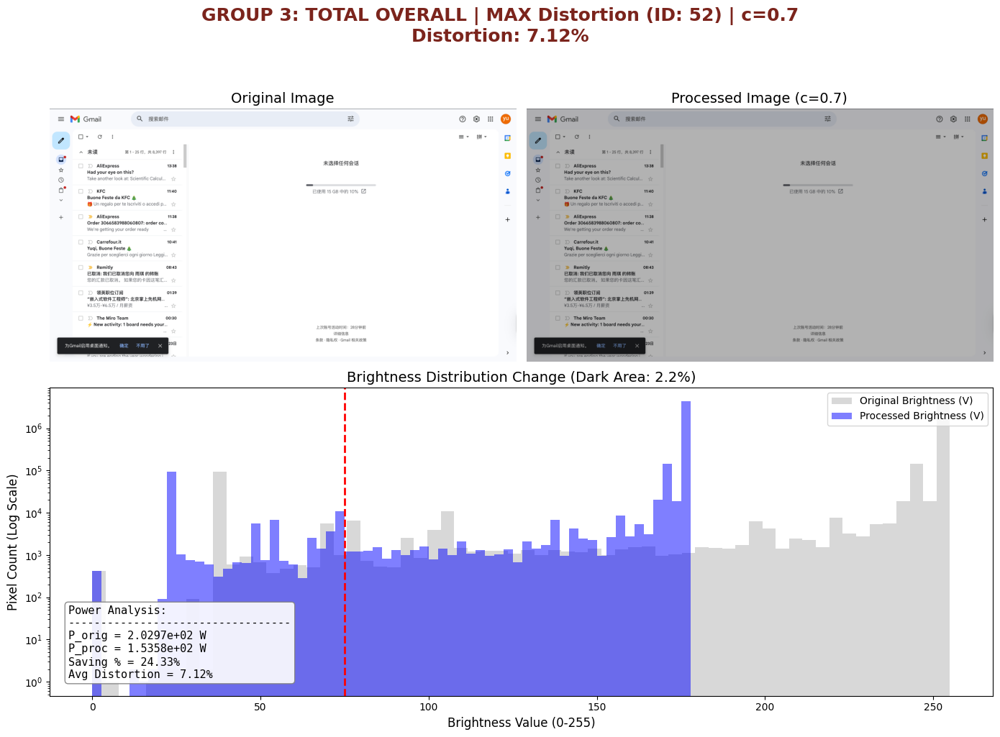

--------------------------------------------------------------------------------------------------------------


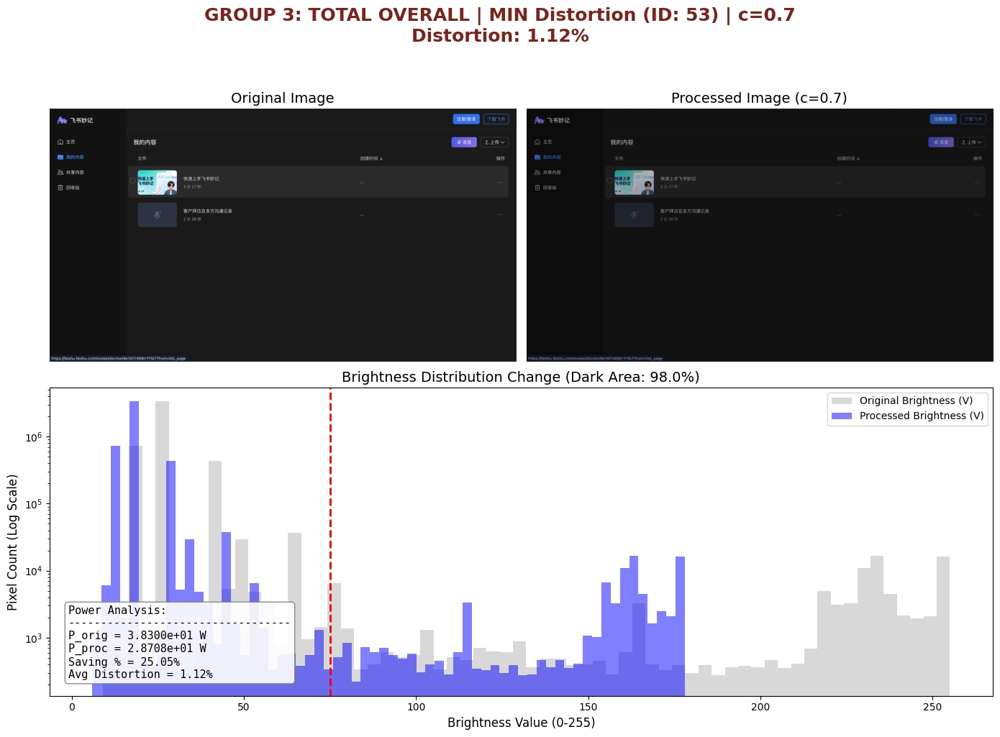

--------------------------------------------------------------------------------------------------------------


In [36]:
#分析max和min的图片，固定显示c=0.5的结果，看看它的亮度分布和失真分布有什么不同
import matplotlib.pyplot as plt
import numpy as np
from skimage import color
from mpl_toolkits.axes_grid1 import make_axes_locatable

# 功耗模型参数
W0 = 1.48169521e-6
GAMMA = 0.7755
W_R, W_G, W_B = 2.13636845e-7, 1.77746705e-7, 2.14348309e-7

def get_power_val(img):
    """计算单张图片的功耗数值"""
    img_f = img.astype(np.float64)
    p_dyn = np.sum(W_R * np.power(img_f[:, :, 0], GAMMA) + 
                   W_G * np.power(img_f[:, :, 1], GAMMA) + 
                   W_B * np.power(img_f[:, :, 2], GAMMA))
    return p_dyn + W0

def plot_deep_analysis_no_heatmap(target_c, group_indices, group_name):
    # 1. 筛选数据
    all_stats = detailed_data_contrast[target_c]
    group_stats = [item for item in all_stats if item['idx'] in group_indices]
    
    if not group_stats: return

    # 2. 定义极值目标
    extreme_targets = [
        ("MAX Saving", max(group_stats, key=lambda x: x['saving'])),
        ("MIN Saving", min(group_stats, key=lambda x: x['saving'])),
        ("MAX Distortion", max(group_stats, key=lambda x: x['dist'])),
        ("MIN Distortion", min(group_stats, key=lambda x: x['dist']))
    ]

    for label, rec in extreme_targets:
        idx = rec['idx']
        orig = all_images[idx]
        proc = apply_contrast_brightness(orig, target_c)
        
        # --- 数据计算 ---
        p_orig = get_power_val(orig)
        p_proc = get_power_val(proc)
        
        v_orig = color.rgb2hsv(orig)[:,:,2] * 255
        v_proc = color.rgb2hsv(proc)[:,:,2] * 255
        dark_threshold = 75
        dark_ratio = (np.sum(v_orig < dark_threshold) / v_orig.size) * 100

        # --- 绘图布局 (修改为 2x2 但合并下方空间) ---
        fig = plt.figure(figsize=(14, 10))
        title_color = '#1b4f72' if "NATURAL" in group_name else '#7b241c'
        fig.suptitle(f"{group_name} | {label} (ID: {idx}) | c={target_c}\nDistortion: {rec['dist']:.2f}%", 
                     fontsize=18, fontweight='bold', color=title_color, y=1.02)

        # (Top Left) 原图
        ax1 = plt.subplot(2, 2, 1)
        ax1.imshow(orig)
        ax1.set_title("Original Image", fontsize=14)
        ax1.axis('off')

        # (Top Right) 处理图
        ax2 = plt.subplot(2, 2, 2)
        ax2.imshow(proc)
        ax2.set_title(f"Processed Image (c={target_c})", fontsize=14)
        ax2.axis('off')

        # (Bottom Row) 亮度分布直方图 - 占据下方整行
        ax_hist = plt.subplot(2, 1, 2)
        ax_hist.hist(v_orig.flatten(), bins=64, color='gray', alpha=0.3, label='Original Brightness (V)')
        ax_hist.hist(v_proc.flatten(), bins=64, color='blue', alpha=0.5, label='Processed Brightness (V)')
        ax_hist.axvline(dark_threshold, color='red', linestyle='--', lw=2)
        ax_hist.set_title(f"Brightness Distribution Change (Dark Area: {dark_ratio:.1f}%)", fontsize=14)
        ax_hist.set_xlabel("Brightness Value (0-255)", fontsize=12)
        ax_hist.set_ylabel("Pixel Count (Log Scale)", fontsize=12)
        ax_hist.set_yscale('log')
        ax_hist.legend(loc='upper right')

        # 添加计算结果和公式说明框
        formula_text = (
            f"Power Analysis:\n"
            f"----------------------------------\n"
            f"P_orig = {p_orig:.4e} W\n"
            f"P_proc = {p_proc:.4e} W\n"
            f"Saving % = {rec['saving']:.2f}%\n"
            f"Avg Distortion = {rec['dist']:.2f}%"
        )
        ax_hist.text(0.02, 0.05, formula_text, transform=ax_hist.transAxes, 
                     fontsize=11, family='monospace', verticalalignment='bottom',
                     bbox=dict(boxstyle='round', facecolor='white', alpha=0.9, edgecolor='gray'))

        plt.tight_layout()
        plt.show()
        print("-" * 110)

# --- 执行分析 ---
TARGET_C = 0.7 

# 你可以根据需要选择运行某个分组

plot_deep_analysis_no_heatmap(TARGET_C, range(0, 50), "GROUP 1: NATURAL IMAGES")
plot_deep_analysis_no_heatmap(TARGET_C, range(50, 55), "GROUP 2: SCREENSHOTS")
plot_deep_analysis_no_heatmap(TARGET_C, range(0, 55), "GROUP 3: TOTAL OVERALL")


--- 高阶视角分析：自然图像 (ID 41) ---


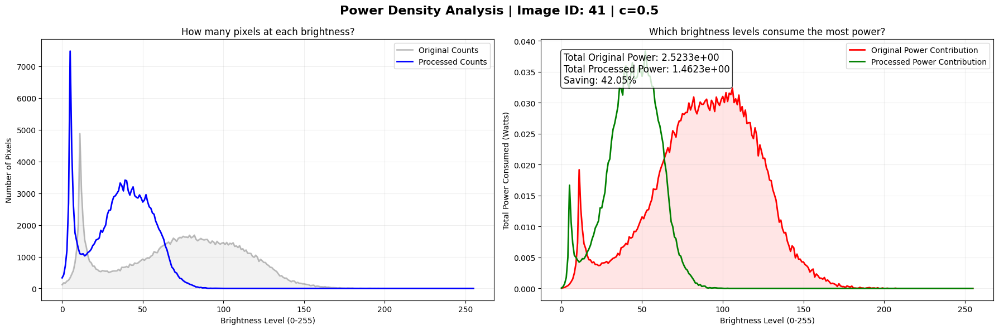


--- 高阶视角分析：屏幕截图 (ID 53) ---


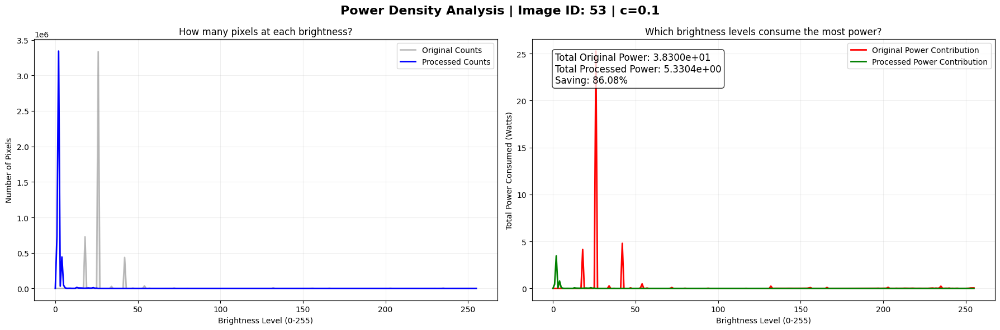

In [37]:
import matplotlib.pyplot as plt
import numpy as np

# 物理常量
W0 = 1.48169521e-6
GAMMA = 0.7755
W_R, W_G, W_B = 2.13636845e-7, 1.77746705e-7, 2.14348309e-7

def analyze_power_density(img, title_suffix=""):
    """分析像素亮度与功耗贡献的关系"""
    img_f = img.astype(np.float64)
    
    # 1. 计算每个像素的亮度 (使用简单的平均亮度或灰度级)
    # 亮度 V = (R + G + B) / 3
    brightness = np.mean(img_f, axis=2).astype(int)
    
    # 2. 计算每个像素的功耗
    pixel_power = (W_R * np.power(img_f[:,:,0], GAMMA) + 
                   W_G * np.power(img_f[:,:,1], GAMMA) + 
                   W_B * np.power(img_f[:,:,2], GAMMA))
    
    # 3. 按亮度等级 (0-255) 分组统计
    pixel_counts = np.zeros(256)
    power_contributions = np.zeros(256)
    
    for b in range(256):
        mask = (brightness == b)
        pixel_counts[b] = np.sum(mask)
        power_contributions[b] = np.sum(pixel_power[mask])
    
    return pixel_counts, power_contributions

def plot_power_density_comparison(idx, c_val):
    orig = all_images[idx]
    proc = apply_contrast_brightness(orig, c_val)
    
    # 获取数据
    orig_counts, orig_power = analyze_power_density(orig)
    proc_counts, proc_power = analyze_power_density(proc)
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))
    fig.suptitle(f"Power Density Analysis | Image ID: {idx} | c={c_val}", fontsize=16, fontweight='bold')

    # --- 左图：像素数量分布 (Pixel Count Distribution) ---
    ax1.plot(orig_counts, color='gray', alpha=0.5, label='Original Counts', lw=2)
    ax1.fill_between(range(256), orig_counts, color='gray', alpha=0.1)
    ax1.plot(proc_counts, color='blue', label='Processed Counts', lw=2)
    ax1.set_title("How many pixels at each brightness?")
    ax1.set_xlabel("Brightness Level (0-255)")
    ax1.set_ylabel("Number of Pixels")
    ax1.legend()
    ax1.grid(True, alpha=0.2)

    # --- 右图：功耗贡献分布 (Power Contribution Distribution) ---
    # 这张图是核心：它显示了电量到底花在了哪个亮度等级上
    ax2.plot(orig_power, color='red', label='Original Power Contribution', lw=2)
    ax2.fill_between(range(256), orig_power, color='red', alpha=0.1)
    ax2.plot(proc_power, color='green', label='Processed Power Contribution', lw=2)
    ax2.set_title("Which brightness levels consume the most power?")
    ax2.set_xlabel("Brightness Level (0-255)")
    ax2.set_ylabel("Total Power Consumed (Watts)")
    ax2.legend()
    ax2.grid(True, alpha=0.2)

    # 标注说明
    total_orig_p = np.sum(orig_power) + W0
    total_proc_p = np.sum(proc_power) + W0
    saving = (total_orig_p - total_proc_p) / total_orig_p * 100
    
    textstr = f"Total Original Power: {total_orig_p:.4e}\nTotal Processed Power: {total_proc_p:.4e}\nSaving: {saving:.2f}%"
    ax2.text(0.05, 0.95, textstr, transform=ax2.transAxes, fontsize=12,
            verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

    plt.tight_layout()
    plt.show()

# 对自然图像冠军和截图冠军各跑一次
print("--- 高阶视角分析：自然图像 (ID 41) ---")
plot_power_density_comparison(41, 0.5)

print("\n--- 高阶视角分析：屏幕截图 (ID 53) ---")
plot_power_density_comparison(53, 0.1)

In [38]:
# Strategy: Pure Histogram Equalization (No Alpha)
# Strategy: Pure Histogram Equalization (No Alpha)
from skimage import color, exposure
import numpy as np

print("正在运行 Standard Histogram Equalization (Baseline)...")

# 存储结果
results_pure_hist = []

for idx, img in enumerate(images):
    # 1. 计算原始功耗
    p_orig = estimate_power_part1(img)
    
    # 2. 转换到 HSV 空间
    # skimage.color.rgb2hsv 会把图像转为 float64 (范围 0-1)
    hsv = color.rgb2hsv(img)
    
    # 3. 对 V 通道 (亮度) 进行直方图均衡化
    # exposure.equalize_hist 输出也是 float64 (范围 0-1)
    hsv[:, :, 2] = exposure.equalize_hist(hsv[:, :, 2])
    
    # 4. 转回 RGB 并还原到 0-255 (uint8)
    img_eq = (color.hsv2rgb(hsv) * 255).astype(np.uint8)
    
    # 5. 计算新功耗
    p_new = estimate_power_part1(img_eq)
    
    # 6. 计算指标
    if p_orig > 0:
        saving = (p_orig - p_new) / p_orig * 100
    else:
        saving = 0
        
    dist = compute_distortion(img, img_eq)
    
    results_pure_hist.append({
        "image_idx": idx,
        "saving": saving,
        "dist": dist
    })

# --- 汇总统计 ---
savings = [r['saving'] for r in results_pure_hist]
dists = [r['dist'] for r in results_pure_hist]

print("\n--- Summary: Standard Histogram Equalization ---")
print("Power Saving Statistics:")
print(f"  Average: {np.mean(savings):.2f}%")
print(f"  Min:     {np.min(savings):.2f}% (负数代表功耗增加)")
print(f"  Max:     {np.max(savings):.2f}%")  # 新增

print("\nDistortion Statistics:")
print(f"  Average: {np.mean(dists):.2f}%")
print(f"  Min:     {np.min(dists):.2f}%")    # 新增
print(f"  Max:     {np.max(dists):.2f}%")

正在运行 Standard Histogram Equalization (Baseline)...

--- Summary: Standard Histogram Equalization ---
Power Saving Statistics:
  Average: 1.48%
  Min:     -38.87% (负数代表功耗增加)
  Max:     26.69%

Distortion Statistics:
  Average: 3.05%
  Min:     1.19%
  Max:     5.83%


Min Saving Image Index: 41 (Saving: -38.87%)
Max Saving Image Index: 0 (Saving: 26.69%)
Min Distortion Image Index: 47 (Dist: 1.19%)
Max Distortion Image Index: 0 (Dist: 5.83%)

--- Case 1: Worst Power Saving (Increased Power) ---


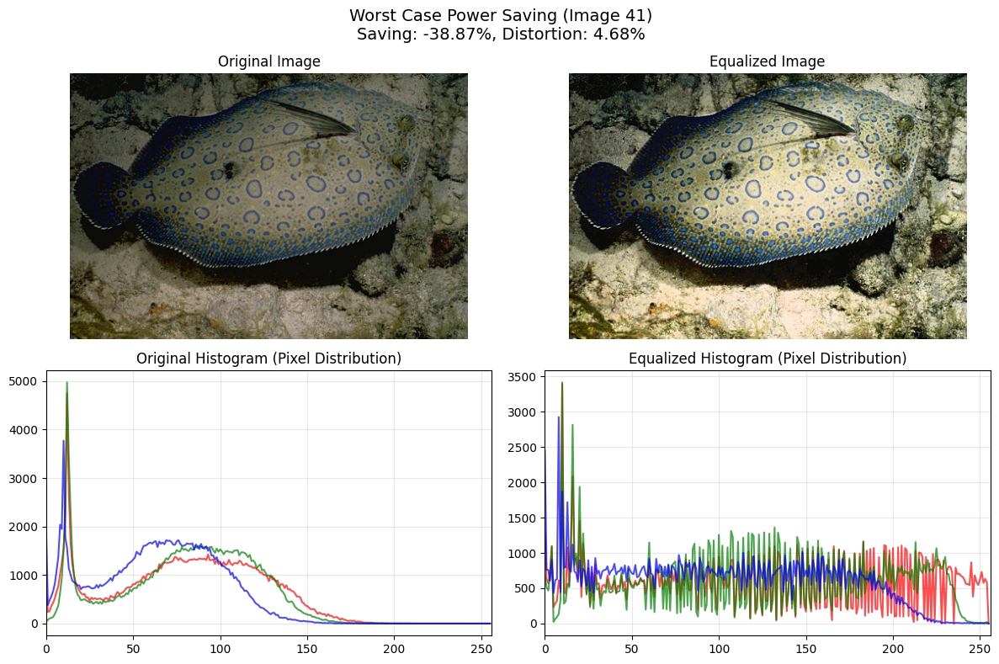


--- Case 2: Best Power Saving ---


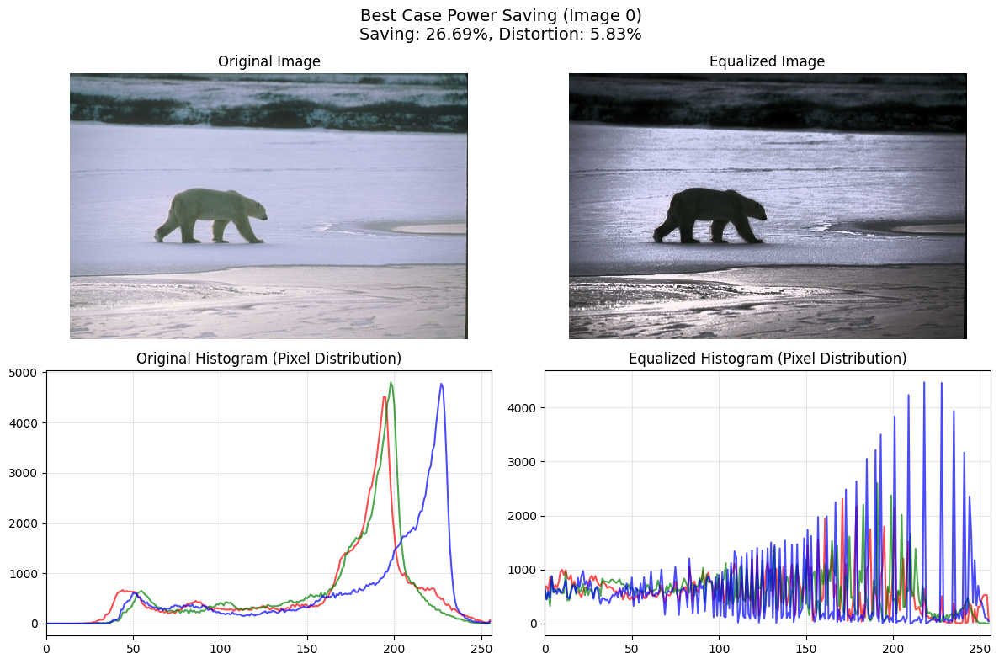


--- Case 3: Min Distortion (Subtle Change) ---


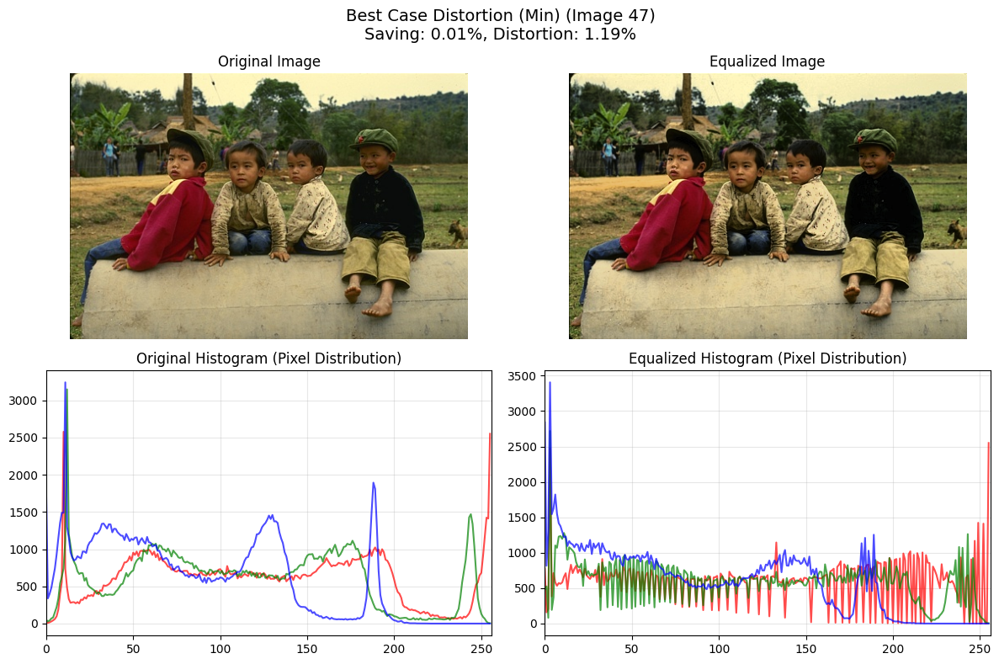


--- Case 4: Max Distortion ---


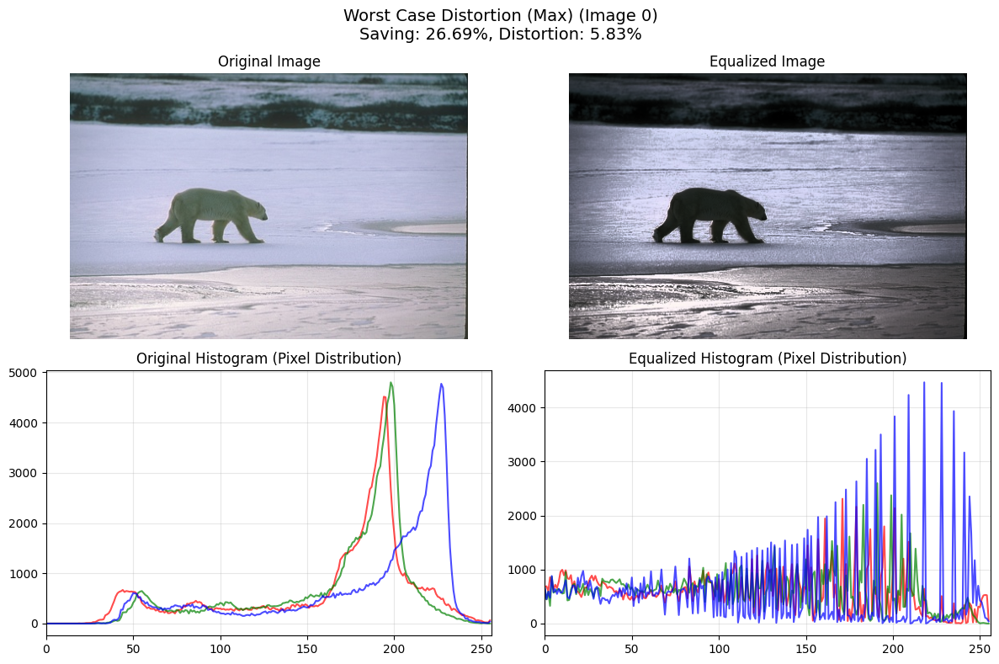

In [39]:
# 分析basic (Part 1: Pure Histogram Equalization Results)
import matplotlib.pyplot as plt
import numpy as np

# 假设 results_pure_hist 已经在之前的代码块里算好了
# results_pure_hist = [{'image_idx': 0, 'saving': 1.2, 'dist': 2.5}, ...]

# 1. 找出关键图片的索引
# 按 saving 排序 (Saving %)
sorted_by_saving = sorted(results_pure_hist, key=lambda x: x['saving'])
min_saving_idx = sorted_by_saving[0]['image_idx']      # 功耗增加最多 (Worst Case)
max_saving_idx = sorted_by_saving[-1]['image_idx']     # 省电最多 (Best Case)

# 按 dist 排序 (Distortion %)
sorted_by_dist = sorted(results_pure_hist, key=lambda x: x['dist'])
min_dist_idx = sorted_by_dist[0]['image_idx']          # 失真最小 (Min Distortion) - NEW!
max_dist_idx = sorted_by_dist[-1]['image_idx']         # 失真最大 (Max Distortion)

# 打印关键索引和数值
print(f"Min Saving Image Index: {min_saving_idx} (Saving: {sorted_by_saving[0]['saving']:.2f}%)")
print(f"Max Saving Image Index: {max_saving_idx} (Saving: {sorted_by_saving[-1]['saving']:.2f}%)")
print(f"Min Distortion Image Index: {min_dist_idx} (Dist: {sorted_by_dist[0]['dist']:.2f}%)") # NEW!
print(f"Max Distortion Image Index: {max_dist_idx} (Dist: {sorted_by_dist[-1]['dist']:.2f}%)")

# 2. 定义绘图函数 (包括图片和直方图)
def plot_comparison(idx, title_prefix):
    img_orig = images[idx]
    
    # 重新做一次变换 (为了拿到变换后的图)
    hsv = color.rgb2hsv(img_orig)
    # 对 V 通道 (亮度) 做直方图均衡化
    hsv[:, :, 2] = exposure.equalize_hist(hsv[:, :, 2])
    img_trans = (color.hsv2rgb(hsv) * 255).astype(np.uint8)
    
    # 计算当前图片的具体数值
    p_orig = estimate_power_part1(img_orig)
    p_new = estimate_power_part1(img_trans)
    saving = (p_orig - p_new) / p_orig * 100 if p_orig > 0 else 0
    dist = compute_distortion(img_orig, img_trans)

    # --- 绘图 ---
    fig, axes = plt.subplots(2, 2, figsize=(12, 8))
    fig.suptitle(f"{title_prefix} (Image {idx})\nSaving: {saving:.2f}%, Distortion: {dist:.2f}%", fontsize=14)
    
    # 原图
    axes[0, 0].imshow(img_orig)
    axes[0, 0].set_title("Original Image")
    axes[0, 0].axis('off')
    
    # 变换后图
    axes[0, 1].imshow(img_trans)
    axes[0, 1].set_title("Equalized Image")
    axes[0, 1].axis('off')
    
    # 原图直方图 (RGB)
    axes[1, 0].set_title("Original Histogram (Pixel Distribution)")
    for i, col in enumerate(['r', 'g', 'b']):
        hist, bins = np.histogram(img_orig[:, :, i], bins=256, range=(0, 256))
        axes[1, 0].plot(bins[:-1], hist, color=col, alpha=0.7)
    axes[1, 0].set_xlim([0, 256])
    axes[1, 0].grid(alpha=0.3)
    
    # 变换后直方图 (RGB)
    axes[1, 1].set_title("Equalized Histogram (Pixel Distribution)")
    for i, col in enumerate(['r', 'g', 'b']):
        hist, bins = np.histogram(img_trans[:, :, i], bins=256, range=(0, 256))
        axes[1, 1].plot(bins[:-1], hist, color=col, alpha=0.7)
    axes[1, 1].set_xlim([0, 256])
    axes[1, 1].grid(alpha=0.3)
    
    plt.tight_layout()
    plt.show()

# 3. 执行绘图
print("\n--- Case 1: Worst Power Saving (Increased Power) ---")
plot_comparison(min_saving_idx, "Worst Case Power Saving")

print("\n--- Case 2: Best Power Saving ---")
plot_comparison(max_saving_idx, "Best Case Power Saving")

print("\n--- Case 3: Min Distortion (Subtle Change) ---") # NEW!
plot_comparison(min_dist_idx, "Best Case Distortion (Min)")

print("\n--- Case 4: Max Distortion ---")
plot_comparison(max_dist_idx, "Worst Case Distortion (Max)")

正在运行 Strategy 3: Histogram Equalization (优化版)...
计算完成！正在汇总数据...

--- Summary Table for Histogram Equalization ---


,Alpha (Weight),Avg Saving %,Min Saving %,Max Saving %,Avg Distortion %,Min Distortion %,Max Distortion %
0,0.0,0.00,0.00,0.00,0.00,0.00,0.00
1,0.2,0.43,-7.65,5.19,0.62,0.25,1.16
2,0.4,0.63,-15.59,10.31,1.23,0.48,2.30
3,0.6,0.91,-23.34,15.62,1.84,0.72,3.47
4,0.8,1.30,-30.95,21.12,2.45,0.96,4.66
5,1.0,1.48,-38.87,26.69,3.05,1.19,5.83


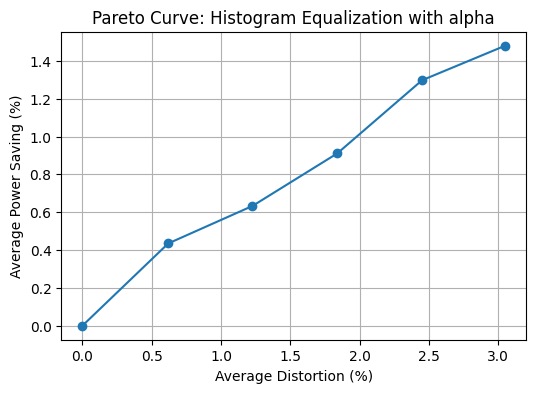

In [40]:
# Strategy 3: Weighted Histogram Equalization
from skimage import color, exposure
import pandas as pd
import numpy as np

# 假设 estimate_power_part1 和 compute_distortion 已经定义好了
# 假设 images 是你的图片列表

results_hist = []
detailed_data_hist = {}

# Alpha 代表 "均衡化图像的权重"。0=原图，1=全均衡化
alphas = [0.0, 0.2, 0.4, 0.6, 0.8, 1.0]

print("正在运行 Strategy 3: Histogram Equalization (优化版)...")

# 为了统计方便，我们把数据结构稍微转置一下：按 alpha 分组
alpha_stats_storage = {a: [] for a in alphas}

for idx, img in enumerate(images):
    # 1. 基础功耗
    p_orig = estimate_power_part1(img)
    
    # 2. 【优化】在循环外只计算一次全均衡化图像 (img_eq)
    # 转换到 HSV
    hsv = color.rgb2hsv(img)
    # 对 V 通道 (hsv[:, :, 2]) 进行均衡化
    # 注意：exposure.equalize_hist 返回的是 float 0-1
    hsv_eq = hsv.copy()
    hsv_eq[:, :, 2] = exposure.equalize_hist(hsv[:, :, 2])
    # 转回 RGB 并还原到 0-255 (uint8)
    img_eq = (color.hsv2rgb(hsv_eq) * 255).astype(np.uint8)
    
    # 3. 遍历 Alpha 进行混合
    for alpha in alphas:
        if alpha == 0:
            img_mixed = img
        elif alpha == 1.0:
            img_mixed = img_eq
        else:
            # 线性插值混合: (1-a)*原图 + a*均衡图
            # 必须先转 float 运算，再转回 uint8
            img_mixed = (img.astype(float) * (1 - alpha) + img_eq.astype(float) * alpha)
            img_mixed = np.clip(img_mixed, 0, 255).astype(np.uint8)
        
        # 计算功耗和失真
        p_new = estimate_power_part1(img_mixed)
        
        if p_orig > 0:
            saving = (p_orig - p_new) / p_orig * 100
        else:
            saving = 0
            
        dist = compute_distortion(img, img_mixed) # 使用之前定义的 LAB 距离函数
        
        # 存入对应 alpha 的列表中
        alpha_stats_storage[alpha].append({
            "image_idx": idx,
            "saving": saving,
            "dist": dist
        })

print("计算完成！正在汇总数据...")

# --- 汇总数据用于展示和画图 ---
stats_list_hist = []

for alpha in alphas:
    stats = alpha_stats_storage[alpha]
    
    # 提取所有图片的 saving 和 dist
    savings = [s['saving'] for s in stats]
    dists = [s['dist'] for s in stats]
    
    # 记录平均值用于画 Pareto 曲线 (Distortion, Saving)
    mean_dist = np.mean(dists)
    mean_saving = np.mean(savings)
    results_hist.append((mean_dist, mean_saving))
    
    # 记录详细统计表
    stats_list_hist.append({
        "Alpha (Weight)": alpha,
        "Avg Saving %": mean_saving,
        "Min Saving %": np.min(savings),
        "Max Saving %": np.max(savings),
        "Avg Distortion %": mean_dist,
        "Min Distortion %": np.min(dists), # 应该是0 (当alpha=0时)
        "Max Distortion %": np.max(dists)
    })

print("\n--- Summary Table for Histogram Equalization ---")
df_hist = pd.DataFrame(stats_list_hist)
display(df_hist.round(2))

# 简单画一下 Pareto 点 (如果你在 Jupyter 里)
import matplotlib.pyplot as plt
plt.figure(figsize=(6,4))
x_val = [r[0] for r in results_hist]
y_val = [r[1] for r in results_hist]
plt.plot(x_val, y_val, marker='o', linestyle='-')
plt.title("Pareto Curve: Histogram Equalization with alpha")
plt.xlabel("Average Distortion (%)")
plt.ylabel("Average Power Saving (%)")
plt.grid(True)
plt.show()

In [41]:
# Strategy 4: Gamma Correction (Detailed Stats Version)
from skimage import exposure, color
import numpy as np
import pandas as pd

gammas = [1.0, 1.2, 1.4, 1.6, 1.8, 2.0]
stats_list_gamma = []

print("Running Detailed Gamma Correction Analysis...")

for gamma in gammas:
    current_savings = []
    current_dists = []
    
    for img in images:
        p_orig = estimate_power_part1(img)
        
        # Gamma Transform
        hsv = color.rgb2hsv(img)
        hsv[:, :, 2] = exposure.adjust_gamma(hsv[:, :, 2], gamma=gamma)
        img_gamma = (color.hsv2rgb(hsv) * 255).astype(np.uint8)
        
        # Metrics
        p_new = estimate_power_part1(img_gamma)
        saving = (p_orig - p_new) / p_orig * 100 if p_orig > 0 else 0
        dist = compute_distortion(img, img_gamma)
        
        current_savings.append(saving)
        current_dists.append(dist)
    
    # 汇总统计
    stats_list_gamma.append({
        "Gamma": gamma,
        "Avg Saving": np.mean(current_savings),
        "Min Saving": np.min(current_savings),
        "Max Saving": np.max(current_savings),
        "Avg Dist": np.mean(current_dists),
        "Min Dist": np.min(current_dists),
        "Max Dist": np.max(current_dists)
    })

# 显示 DataFrame (可以直接把这几行数据填到 LaTeX 表格里)
df_gamma = pd.DataFrame(stats_list_gamma)
print("\n--- Gamma Correction Detailed Statistics ---")
display(df_gamma.round(2))

Running Detailed Gamma Correction Analysis...

--- Gamma Correction Detailed Statistics ---


,Gamma,Avg Saving,Min Saving,Max Saving,Avg Dist,Min Dist,Max Dist
0,1.0,0.15,0.05,0.38,0.07,0.03,0.10
1,1.2,9.17,4.53,15.35,1.49,0.98,1.87
2,1.4,16.79,8.45,27.62,2.73,1.83,3.35
3,1.6,23.43,12.08,37.86,3.79,2.59,4.64
4,1.8,29.27,15.44,46.43,4.71,3.23,5.81
5,2.0,34.40,18.54,53.61,5.50,3.80,6.82


开始运行 Gamma 校正策略分析...
配置完成: Gamma = 1.0 -> 平均省电: 0.15%, 平均失真: 0.07%
配置完成: Gamma = 1.2 -> 平均省电: 9.17%, 平均失真: 1.49%
配置完成: Gamma = 1.4 -> 平均省电: 16.79%, 平均失真: 2.73%
配置完成: Gamma = 1.6 -> 平均省电: 23.43%, 平均失真: 3.79%
配置完成: Gamma = 1.8 -> 平均省电: 29.27%, 平均失真: 4.71%
配置完成: Gamma = 2.0 -> 平均省电: 34.40%, 平均失真: 5.50%

--- 最终汇总数据表 ---


,Gamma,Avg Saving (%),Avg Distortion (%)
0,1.0,0.15,0.07
1,1.2,9.17,1.49
2,1.4,16.79,2.73
3,1.6,23.43,3.79
4,1.8,29.27,4.71
5,2.0,34.40,5.50


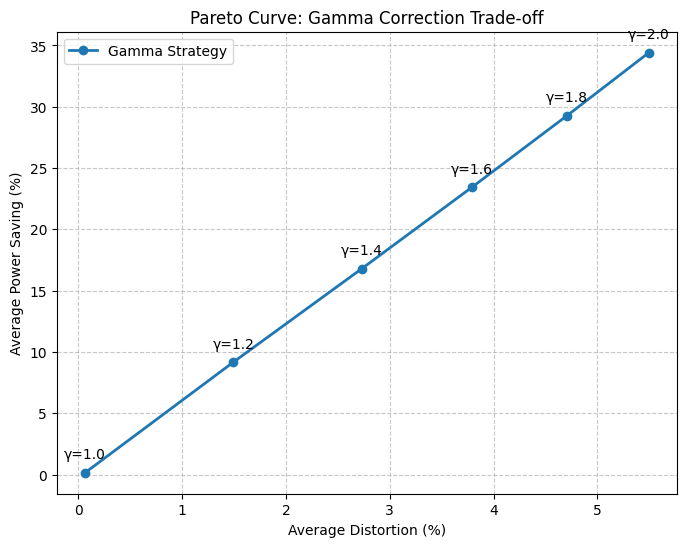

In [42]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from skimage import exposure, color

# 1. 定义你要测试的 Gamma 值列表
# 你提到了 1.2 和 1.6，为了曲线好看，我们可以多加几个点
gammas = [1.0, 1.2, 1.4, 1.6, 1.8, 2.0]

# 用于存储每个 Gamma 设置下的最终平均结果
summary_results = []

print("开始运行 Gamma 校正策略分析...")

# --- 外层循环：遍历不同的配置参数 (Gamma) ---
for gamma in gammas:
    
    # 临时列表，用于存储当前 Gamma 下 50 张图的具体数据
    current_savings = []
    current_dists = []
    
    # --- 内层循环：遍历每一张图片 ---
    for img in images:
        # A. 计算原始功耗
        p_orig = estimate_power_part1(img)
        
        # B. 应用 Gamma 变换 (核心算法)
        # 转 HSV -> 调节 V 通道 -> 转回 RGB
        hsv = color.rgb2hsv(img)
        hsv[:, :, 2] = exposure.adjust_gamma(hsv[:, :, 2], gamma=gamma)
        img_new = (color.hsv2rgb(hsv) * 255).astype(np.uint8)
        
        # C. 计算新指标
        p_new = estimate_power_part1(img_new)
        
        # 省电率
        if p_orig > 0:
            saving = (p_orig - p_new) / p_orig * 100
        else:
            saving = 0
            
        # 失真率
        dist = compute_distortion(img, img_new)
        
        # D. 收集数据
        current_savings.append(saving)
        current_dists.append(dist)
    
    # --- 计算当前 Gamma 下的“平均”表现 ---
    avg_saving = np.mean(current_savings)
    avg_dist = np.mean(current_dists)
    
    # 存入汇总列表
    summary_results.append({
        "Gamma": gamma,
        "Avg Saving (%)": avg_saving,
        "Avg Distortion (%)": avg_dist
    })
    
    print(f"配置完成: Gamma = {gamma} -> 平均省电: {avg_saving:.2f}%, 平均失真: {avg_dist:.2f}%")

# --- 2. 展示数据表格 ---
df_summary = pd.DataFrame(summary_results)
print("\n--- 最终汇总数据表 ---")
display(df_summary.round(2))

# --- 3. 绘制 Pareto 曲线 ---
plt.figure(figsize=(8, 6))

# 提取 X (失真) 和 Y (省电)
x_vals = df_summary["Avg Distortion (%)"]
y_vals = df_summary["Avg Saving (%)"]
labels = df_summary["Gamma"]

# 画线和点
plt.plot(x_vals, y_vals, marker='o', linestyle='-', linewidth=2, color='tab:blue', label='Gamma Strategy')

# 给每个点标上 Gamma 值，方便老师看
for i, txt in enumerate(labels):
    plt.annotate(f"γ={txt}", 
                 (x_vals[i], y_vals[i]), 
                 textcoords="offset points", 
                 xytext=(0,10), 
                 ha='center')

# 装饰图表
plt.xlabel("Average Distortion (%)")
plt.ylabel("Average Power Saving (%)")
plt.title("Pareto Curve: Gamma Correction Trade-off")
plt.grid(True, linestyle='--', alpha=0.7)
plt.legend()

# 显示
plt.show()

In [43]:
#寻找特定gamma下的极值图片
import numpy as np
import pandas as pd
from skimage import exposure, color

# 假设你的图片列表叫 images，并且评估函数已经定义好
target_gamma = 1.4
image_details = []

print(f"正在分析 Gamma = {target_gamma} 时的单张图片数据...")

# 使用 enumerate 来获取每张图片的索引 (i)
for i, img in enumerate(images):
    p_orig = estimate_power_part1(img)
    
    # Gamma Transform
    hsv = color.rgb2hsv(img)
    hsv[:, :, 2] = exposure.adjust_gamma(hsv[:, :, 2], gamma=target_gamma)
    img_gamma = (color.hsv2rgb(hsv) * 255).astype(np.uint8)
    
    # Metrics
    p_new = estimate_power_part1(img_gamma)
    saving = (p_orig - p_new) / p_orig * 100 if p_orig > 0 else 0
    dist = compute_distortion(img, img_gamma)
    
    # 把这张图片的索引和结果存起来
    image_details.append({
        "Image_Index": i,  # 如果你有文件名列表，这里可以用 file_names[i]
        "Saving": saving,
        "Distortion": dist
    })

# 转换成 DataFrame 方便查找极值
df_details = pd.DataFrame(image_details)

# --- 核心查找逻辑 ---
# idxmax() 和 idxmin() 会返回对应列最大/最小值的行索引
idx_max_dist = df_details['Distortion'].idxmax()
idx_min_dist = df_details['Distortion'].idxmin()
idx_max_saving = df_details['Saving'].idxmax()
idx_min_saving = df_details['Saving'].idxmin()

print("\n--- 极端情况图片提取结果 (Gamma=1.4) ---")
print(f"最大失真 (Max Dist) 图片索引: {df_details.loc[idx_max_dist, 'Image_Index']}, 失真值: {df_details.loc[idx_max_dist, 'Distortion']:.2f}")
print(f"最小失真 (Min Dist) 图片索引: {df_details.loc[idx_min_dist, 'Image_Index']}, 失真值: {df_details.loc[idx_min_dist, 'Distortion']:.2f}")
print(f"最大节能 (Max Saving) 图片索引: {df_details.loc[idx_max_saving, 'Image_Index']}, 节能值: {df_details.loc[idx_max_saving, 'Saving']:.2f}%")
print(f"最小节能 (Min Saving) 图片索引: {df_details.loc[idx_min_saving, 'Image_Index']}, 节能值: {df_details.loc[idx_min_saving, 'Saving']:.2f}%")

正在分析 Gamma = 1.4 时的单张图片数据...

--- 极端情况图片提取结果 (Gamma=1.4) ---
最大失真 (Max Dist) 图片索引: 8, 失真值: 3.35
最小失真 (Min Dist) 图片索引: 0, 失真值: 1.83
最大节能 (Max Saving) 图片索引: 8, 节能值: 27.62%
最小节能 (Min Saving) 图片索引: 0, 节能值: 8.45%


Starting HSV comparison visualization for Gamma=1.4 extreme cases...


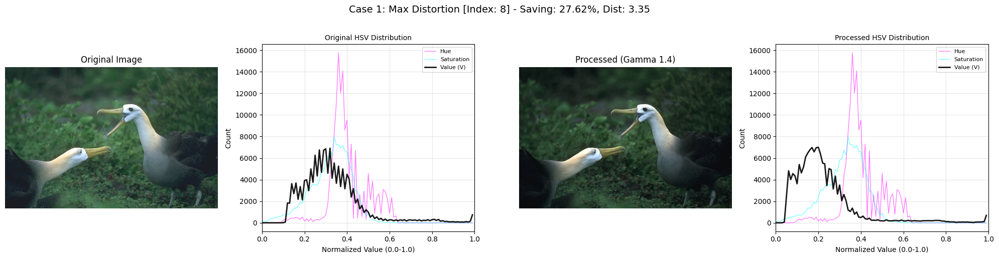

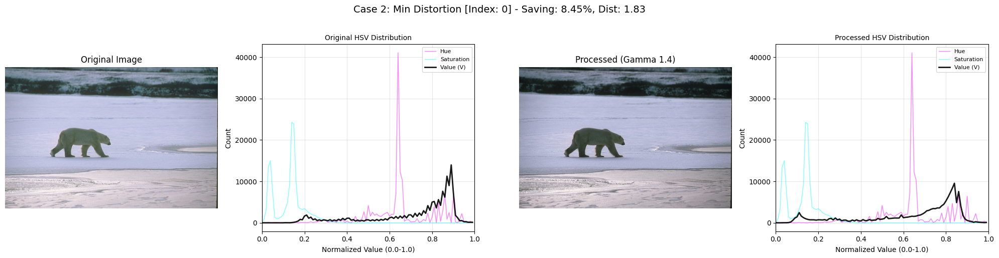

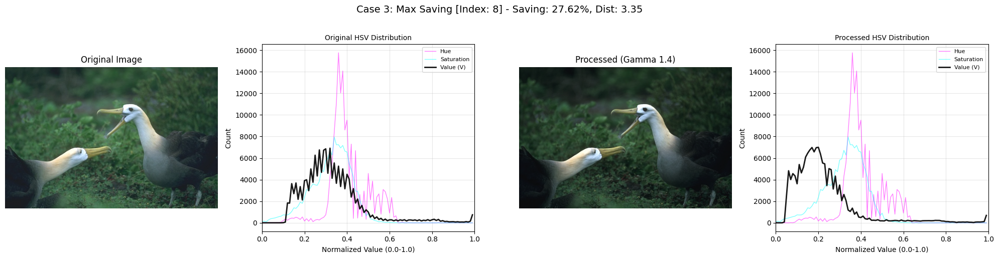

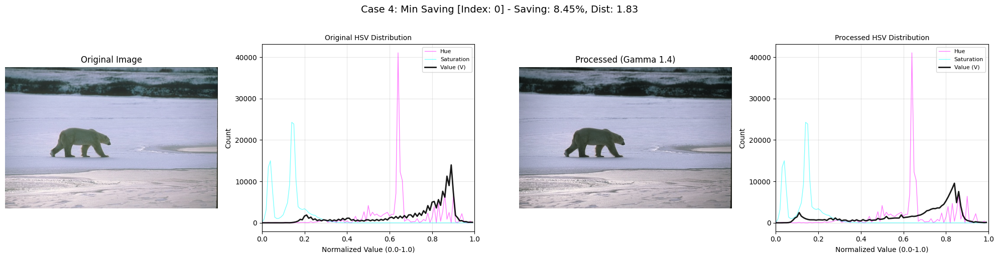

Visualization finished.


In [44]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import color, exposure

# --- 1. Helper Functions Definitions ---

def apply_gamma_and_get_hsv(img_rgb, gamma_val):
    """Helper: Applies Gamma to V channel and returns processed RGB and both HSV arrays."""
    hsv_original = color.rgb2hsv(img_rgb)
    hsv_processed = hsv_original.copy()
    
    # Apply Gamma to the V (Value) channel
    hsv_processed[:, :, 2] = exposure.adjust_gamma(hsv_processed[:, :, 2], gamma=gamma_val)
    
    # Convert back to RGB for display (clip to 0-255 and cast to uint8)
    img_processed = np.clip(color.hsv2rgb(hsv_processed) * 255, 0, 255).astype(np.uint8)
    
    # Return both original and processed HSV data for comparison
    return img_processed, hsv_original, hsv_processed

def plot_hsv_histogram(ax, hsv_data, title_text, highlight_v=True):
    """Helper: Plots HSV histograms. Emphasizes V channel if highlight_v is True."""
    labels = ['Hue', 'Saturation', 'Value (V)']
    
    # Emphasize V channel with bold black line
    plot_styles = [
        {'color': 'magenta', 'lw': 1, 'alpha': 0.5}, # Hue style
        {'color': 'cyan', 'lw': 1, 'alpha': 0.5},    # Saturation style
        {'color': 'black', 'lw': 2 if highlight_v else 1.5, 'alpha': 0.9 if highlight_v else 0.7} # Value style
    ]

    for i, style in enumerate(plot_styles):
        hist, bins = np.histogram(hsv_data[:, :, i].flatten(), bins=100, range=[0.0, 1.0])
        ax.plot(bins[:-1], hist, label=labels[i], **style)
    
    ax.set_title(title_text, fontsize=10)
    ax.set_xlim([0.0, 1.0])
    ax.set_xlabel("Normalized Value (0.0-1.0)")
    ax.set_ylabel("Count")
    ax.legend(loc='upper right', fontsize=8)
    ax.grid(True, alpha=0.3)

# --- 2. Main Visualization Loop ---

target_gamma = 1.4

# Define the four extreme cases using the indices found previously
# Make sure idx_max_dist, idx_min_dist, idx_max_saving, idx_min_saving are in memory
cases_to_analyze = [
    ("Case 1: Max Distortion", idx_max_dist),
    ("Case 2: Min Distortion", idx_min_dist),
    ("Case 3: Max Saving", idx_max_saving),
    ("Case 4: Min Saving", idx_min_saving)
]

print(f"Starting HSV comparison visualization for Gamma={target_gamma} extreme cases...")

for case_name, img_idx in cases_to_analyze:
    # A. Prepare Data
    img_orig = images[img_idx]
    
    # Now unpacking three variables instead of two
    img_proc, hsv_orig, hsv_proc = apply_gamma_and_get_hsv(img_orig, target_gamma)
    
    # B. Re-calculate metrics specific to this image for the main title
    p_orig_val = estimate_power_part1(img_orig)
    p_new_val = estimate_power_part1(img_proc)
    sav_val = (p_orig_val - p_new_val) / p_orig_val * 100 if p_orig_val > 0 else 0
    dist_val = compute_distortion(img_orig, img_proc)

    # C. Create Figure Canvas (1 row, 4 columns)
    fig, axes = plt.subplots(1, 4, figsize=(20, 5))
    main_title = f"{case_name} [Index: {img_idx}] - Saving: {sav_val:.2f}%, Dist: {dist_val:.2f}"
    fig.suptitle(main_title, fontsize=14, y=1.02)

    # D. Plot Subplots
    
    # Subplot 1: Original Image
    axes[0].imshow(img_orig)
    axes[0].set_title("Original Image")
    axes[0].axis('off')

    # Subplot 2: Original HSV Histogram
    plot_hsv_histogram(axes[1], hsv_orig, "Original HSV Distribution", highlight_v=True)

    # Subplot 3: Processed Image
    axes[2].imshow(img_proc)
    axes[2].set_title(f"Processed (Gamma {target_gamma})")
    axes[2].axis('off')

    # Subplot 4: Processed HSV Histogram
    plot_hsv_histogram(axes[3], hsv_proc, "Processed HSV Distribution", highlight_v=True)

    plt.tight_layout()
    plt.show()

print("Visualization finished.")

L的偏移量对于鸟来说很大，但是对于熊来说几乎没变，因为当hsv再转换回RGB时同样不会变换很大，因此从RGB转换成Lab空间时，熊lab的orignal和proc的差值就不会大。

=== 开始寻找 Distortion < 3% 时的最大 Saving ===
正在遍历 Hungry Blue 的所有参数...
  -> 最优参数: 20, 此时失真: 2.86%, 节能: 5.79%
正在遍历 Brightness Scaling 的所有参数...
  -> 最优参数: 0.8, 此时失真: 2.72%, 节能: 16.23%
正在遍历 Histogram Equalization 的所有参数...
  -> 最优参数: 0.8, 此时失真: 2.45%, 节能: 1.30%
正在遍历 Gamma Correction 的所有参数...
  -> 最优参数: 1.4, 此时失真: 2.73%, 节能: 16.79%


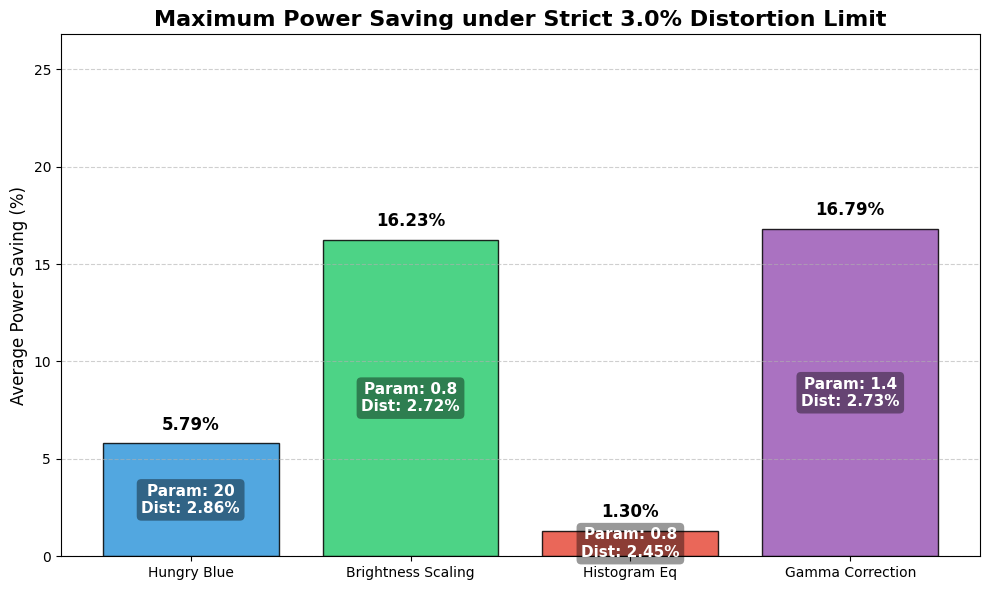

In [45]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure, color

# 1. 统一定义参数范围 (你可以根据需要增删)
k_values = list(range(0, 256, 10))
c_values = [1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
alphas = [0.0, 0.2, 0.4, 0.6, 0.8, 1.0]
# 扩充一点 Gamma 的范围，以确保能找到 3% 临界点附近的最优解
gammas = [1.0, 1.2, 1.4, 1.6, 1.8, 2.0, 2.2, 2.4, 2.6, 2.8, 3.0] 

# 2. 定义统一的测试函数
def find_best_saving_under_limit(img_list, transform_func, params, strategy_name, dist_limit=3.0):
    best_saving = 0
    best_param = None
    best_dist = 0
    
    print(f"正在遍历 {strategy_name} 的所有参数...")
    for p in params:
        savings = []
        dists = []
        for img in img_list:
            p_orig = estimate_power_part1(img)
            img_new = transform_func(img, p)
            p_new = estimate_power_part1(img_new)
            
            saving = (p_orig - p_new) / p_orig * 100 if p_orig > 0 else 0
            dist = compute_distortion(img, img_new)
            
            savings.append(saving)
            dists.append(dist)
            
        avg_saving = np.mean(savings)
        avg_dist = np.mean(dists)
        
        # 核心逻辑：失真必须严格小于 limit (3.0%)
        if avg_dist < dist_limit:
            # 在满足条件的参数中，寻找 saving 最大的
            if avg_saving > best_saving:
                best_saving = avg_saving
                best_param = p
                best_dist = avg_dist
                
    print(f"  -> 最优参数: {best_param}, 此时失真: {best_dist:.2f}%, 节能: {best_saving:.2f}%")
    return best_saving, best_param, best_dist

# 3. 包装各种策略的转换函数 (基于你之前的代码)
def wrapper_hungry_blue(img, k):
    return apply_hungry_blue(img, k)

def wrapper_brightness(img, c):
    return apply_contrast_brightness(img, c)

def wrapper_he(img, alpha):
    hsv = color.rgb2hsv(img)
    hsv_eq = hsv.copy()
    hsv_eq[:, :, 2] = exposure.equalize_hist(hsv[:, :, 2])
    img_eq = (color.hsv2rgb(hsv_eq) * 255).astype(np.uint8)
    img_mixed = (img.astype(float) * (1 - alpha) + img_eq.astype(float) * alpha)
    return np.clip(img_mixed, 0, 255).astype(np.uint8)

def wrapper_gamma(img, gamma):
    hsv = color.rgb2hsv(img)
    hsv[:, :, 2] = exposure.adjust_gamma(hsv[:, :, 2], gamma=gamma)
    return (color.hsv2rgb(hsv) * 255).astype(np.uint8)

# 4. 运行评估 (针对 50 张自然图像 images)
print("=== 开始寻找 Distortion < 3% 时的最大 Saving ===")
DIST_LIMIT = 3.0
dataset_to_test = images 

res_hb = find_best_saving_under_limit(dataset_to_test, wrapper_hungry_blue, k_values, "Hungry Blue", DIST_LIMIT)
res_bs = find_best_saving_under_limit(dataset_to_test, wrapper_brightness, c_values, "Brightness Scaling", DIST_LIMIT)
res_he = find_best_saving_under_limit(dataset_to_test, wrapper_he, alphas, "Histogram Equalization", DIST_LIMIT)
res_gm = find_best_saving_under_limit(dataset_to_test, wrapper_gamma, gammas, "Gamma Correction", DIST_LIMIT)

# 5. 可视化最终的柱状对比图
strategies = ['Hungry Blue', 'Brightness Scaling', 'Histogram Eq', 'Gamma Correction']
best_savings = [res_hb[0], res_bs[0], res_he[0], res_gm[0]]
best_params = [res_hb[1], res_bs[1], res_he[1], res_gm[1]]
actual_dists = [res_hb[2], res_bs[2], res_he[2], res_gm[2]]

plt.figure(figsize=(10, 6))
bars = plt.bar(strategies, best_savings, color=['#3498db', '#2ecc71', '#e74c3c', '#9b59b6'], alpha=0.85, edgecolor='black')

plt.title(f'Maximum Power Saving under Strict {DIST_LIMIT}% Distortion Limit', fontsize=16, fontweight='bold')
plt.ylabel('Average Power Saving (%)', fontsize=12)

# 根据最高 saving 留出顶部空间
max_y = max(best_savings)
plt.ylim(0, max_y + 10 if max_y > 0 else 10) 
plt.grid(axis='y', linestyle='--', alpha=0.6)

# 在柱子上添加详细的数据标签
for bar, param, dist in zip(bars, best_params, actual_dists):
    height = bar.get_height()
    
    # 顶部显示节能百分比
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.5,
             f'{height:.2f}%', 
             ha='center', va='bottom', fontsize=12, fontweight='bold', color='black')
             
    # 柱子中间显示所用的最优参数和对应的真实失真率
    if height > 0:
        info_text = f"Param: {param}\nDist: {dist:.2f}%"
        plt.text(bar.get_x() + bar.get_width()/2., height / 2,
                 info_text, 
                 ha='center', va='center', fontsize=11, color='white', fontweight='bold',
                 bbox=dict(facecolor='black', alpha=0.4, edgecolor='none', boxstyle='round,pad=0.3'))
    else:
        # 如果 Saving 为 0（例如 HE 在某些情况下达不到），在底部标出
        plt.text(bar.get_x() + bar.get_width()/2., 1, "No Saving", ha='center', fontsize=10)

plt.tight_layout()
plt.show()

正在计算 4 种核心策略的对比数据 (基于 images 列表)...
Running Hungry Blue...
Running Brightness Scaling...
Running Gamma Correction...
Running Histogram Eq (Mix)...


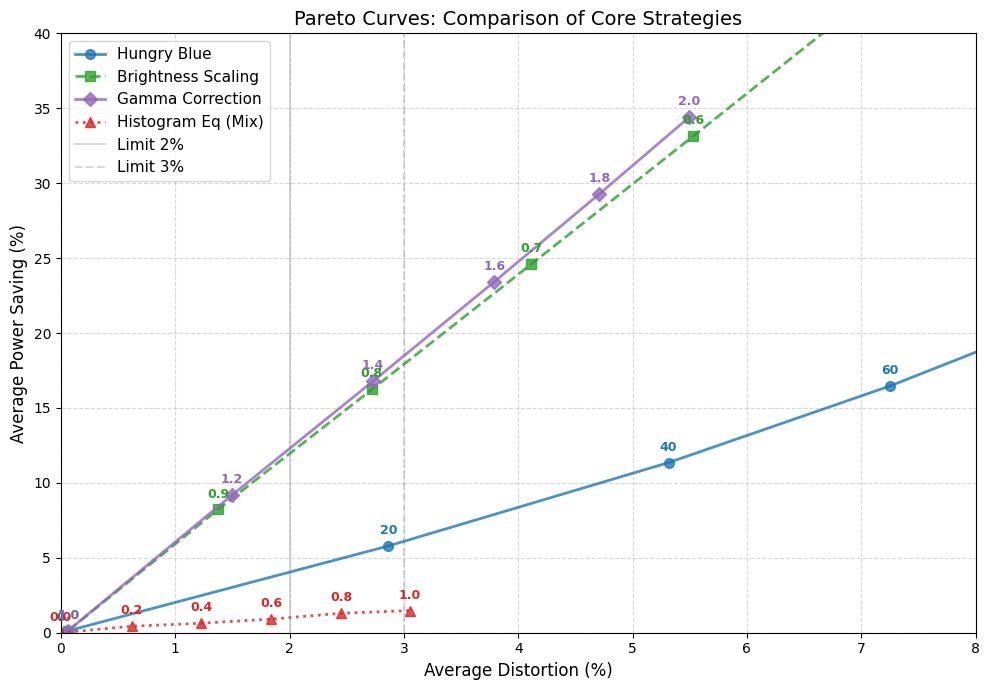

In [46]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import exposure, color

# ==========================================
# 1. 定义 4 种策略的 Wrapper 函数
# ==========================================

def wrapper_hungry_blue(img, k):
    img_mod = img.astype(np.int16)
    img_mod[:, :, 2] = img_mod[:, :, 2] - k
    return np.clip(img_mod, 0, 255).astype(np.uint8)

def wrapper_brightness(img, c):
    hsv = color.rgb2hsv(img)
    hsv[:, :, 2] *= c
    return (color.hsv2rgb(hsv) * 255).astype(np.uint8)

def wrapper_he(img, alpha):
    hsv = color.rgb2hsv(img)
    hsv_eq = hsv.copy()
    hsv_eq[:, :, 2] = exposure.equalize_hist(hsv[:, :, 2])
    img_eq = (color.hsv2rgb(hsv_eq) * 255).astype(np.uint8)
    img_mixed = (img.astype(float) * (1 - alpha) + img_eq.astype(float) * alpha)
    return np.clip(img_mixed, 0, 255).astype(np.uint8)

def wrapper_gamma(img, gamma):
    hsv = color.rgb2hsv(img)
    hsv[:, :, 2] = exposure.adjust_gamma(hsv[:, :, 2], gamma=gamma)
    return (color.hsv2rgb(hsv) * 255).astype(np.uint8)

# ==========================================
# 2. 配置参数 (优化了 Hungry Blue 范围)
# ==========================================
strategies_config = {
    "Hungry Blue": {
        "func": wrapper_hungry_blue,
        "params": range(0, 101, 20), # k: 0, 20, 40, 60, 80, 100 (缩小范围，更具对比性)
        "style": {"color": "tab:blue", "marker": "o", "linestyle": "-"}
    },
    "Brightness Scaling": {
        "func": wrapper_brightness,
        "params": [1.0, 0.9, 0.8, 0.7, 0.6, 0.5], 
        "style": {"color": "tab:green", "marker": "s", "linestyle": "--"}
    },
    "Gamma Correction": {
        "func": wrapper_gamma,
        "params": [1.0, 1.2, 1.4, 1.6, 1.8, 2.0], 
        "style": {"color": "tab:purple", "marker": "D", "linestyle": "-"}
    },
    "Histogram Eq (Mix)": {
        "func": wrapper_he,
        "params": [0.0, 0.2, 0.4, 0.6, 0.8, 1.0], 
        "style": {"color": "tab:red", "marker": "^", "linestyle": ":"}
    }
}

# ==========================================
# 3. 计算数据
# ==========================================
results_all = {}
print("正在计算 4 种核心策略的对比数据 (基于 images 列表)...")

for name, config in strategies_config.items():
    print(f"Running {name}...")
    avg_dists = []
    avg_savings = []
    
    for p in config["params"]:
        dists = []
        savings = []
        for img in images: # 确保 'images' 列表已加载
            p_orig = estimate_power_part1(img)
            img_new = config["func"](img, p)
            p_new = estimate_power_part1(img_new)
            
            saving = (p_orig - p_new) / p_orig * 100 if p_orig > 0 else 0
            dist = compute_distortion(img, img_new)
            
            savings.append(saving)
            dists.append(dist)
            
        avg_dists.append(np.mean(dists))
        avg_savings.append(np.mean(savings))
        
    results_all[name] = {"x": avg_dists, "y": avg_savings}

# ==========================================
# 4. 绘图 (带边界检查)
# ==========================================
plt.figure(figsize=(10, 7))

# 定义可视范围
X_LIMIT = 8.0
Y_LIMIT = 40.0

for name, data in results_all.items():
    style = strategies_config[name]["style"]
    
    # 绘制线条和点
    plt.plot(data["x"], data["y"], 
             label=name,
             color=style["color"],
             marker=style["marker"],
             linestyle=style["linestyle"],
             linewidth=2, markersize=7, alpha=0.8)
    
    # 标注关键参数点
    params = strategies_config[name]["params"]
    # 标注索引 1, 2, 3 的点 (根据参数数量调整)
    indices_to_label = list(range(len(params))) 
    
    if len(params) > max(indices_to_label):
        for idx in indices_to_label:
            x_pos = data["x"][idx]
            y_pos = data["y"][idx]
            p_val = params[idx]
            
            # 【修复关键】只有当点在 X 轴范围内时，才画标签
            if x_pos <= X_LIMIT and y_pos <= Y_LIMIT:
                p_str = f"{p_val:.1f}" if isinstance(p_val, float) else f"{p_val}"
                
                # 微调位置，防止和点重叠
                plt.text(x_pos, y_pos + 0.8, 
                         p_str, 
                         fontsize=9, color=style["color"], fontweight='bold', ha='center')

# 添加失真约束参考线
plt.axvline(x=2.0, color='gray', linestyle='-', alpha=0.3, label='Limit 2%')
plt.axvline(x=3.0, color='gray', linestyle='--', alpha=0.3, label='Limit 3%')

plt.title('Pareto Curves: Comparison of Core Strategies', fontsize=14)
plt.xlabel('Average Distortion (%)', fontsize=12)
plt.ylabel('Average Power Saving (%)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend(fontsize=11, loc='upper left')

# 设置坐标轴范围
plt.xlim(0, X_LIMIT)  
plt.ylim(0, Y_LIMIT)

plt.tight_layout()
plt.show()

策略三：
Unlike Hungry Blue and Brightness Scaling which systematically reduce pixel intensity (luminance) to save power, Histogram Equalization merely redistributes the pixel intensities to enhance contrast. Consequently, the net change in total luminance (and thus power consumption) is minimal or negligible on average, resulting in a very short curve on the Pareto plot.

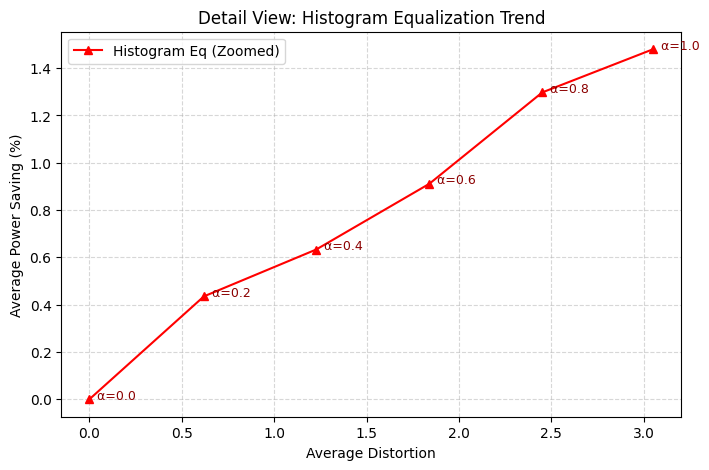

上图放大了 Strategy 3 的细节，你可以清晰看到它的走势。


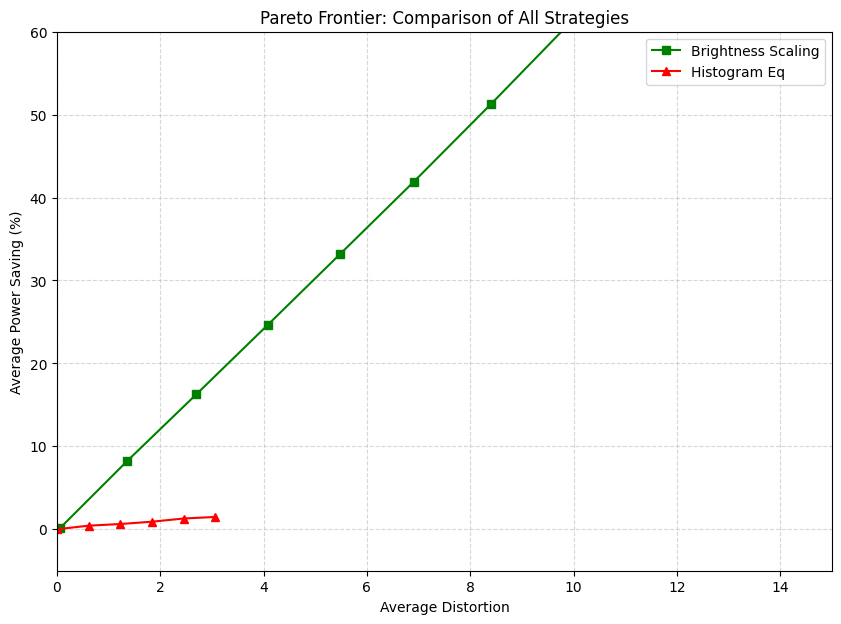

上图是最终对比图。Strategy 3 的曲线非常短小，这符合它“重新分配亮度而非单纯减去亮度”的原理。


In [47]:
import matplotlib.pyplot as plt

# --- 1. 放大细节图 (Zoomed View for Strategy 3) ---
# 这张图专门用来展示直方图均衡化的内部走势
if 'results_hist' in locals() and results_hist:
    x_hist = [r[0] for r in results_hist]
    y_hist = [r[1] for r in results_hist]

    plt.figure(figsize=(8, 5))
    plt.plot(x_hist, y_hist, 'r-^', label='Histogram Eq (Zoomed)')
    
    # 标注 alpha 值
    for x, y, a in zip(x_hist, y_hist, alphas):
        plt.text(x, y, f'  α={a:.1f}', fontsize=9, color='darkred')

    plt.title('Detail View: Histogram Equalization Trend')
    plt.xlabel('Average Distortion')
    plt.ylabel('Average Power Saving (%)')
    plt.grid(True, linestyle='--', alpha=0.5)
    
    # 让坐标轴自动适应数据范围，从而实现“放大”效果
    plt.autoscale(enable=True, axis='both', tight=False)
    plt.legend()
    plt.show()
    print("上图放大了 Strategy 3 的细节，你可以清晰看到它的走势。")
else:
    print("⚠️ 缺少 results_hist 数据，请先运行策略 3 的代码。")


# --- 2. 最终对比图 (Final Comparison - Full Scale) ---
# 这张图展示所有策略的真实比例对比
plt.figure(figsize=(10, 7))

# 绘制 Strategy 1
if 'results_hungry_blue' in locals() and results_hungry_blue:
    x_blue = [r[0] for r in results_hungry_blue]
    y_blue = [r[1] for r in results_hungry_blue]
    plt.plot(x_blue, y_blue, 'b-o', label='Hungry Blue')

# 绘制 Strategy 2
if 'results_contrast' in locals() and results_contrast:
    x_cont = [r[0] for r in results_contrast]
    y_cont = [r[1] for r in results_contrast]
    plt.plot(x_cont, y_cont, 'g-s', label='Brightness Scaling')

# 绘制 Strategy 3
if 'results_hist' in locals() and results_hist:
    # 这里不需要再次提取 x_hist, y_hist，直接复用或重新提取均可
    x_hist = [r[0] for r in results_hist]
    y_hist = [r[1] for r in results_hist]
    plt.plot(x_hist, y_hist, 'r-^', label='Histogram Eq')

plt.title('Pareto Frontier: Comparison of All Strategies')
plt.xlabel('Average Distortion')
plt.ylabel('Average Power Saving (%)')
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()

# 设置一个宏观的坐标范围，展示真实的“短小”对比
# 根据经验，Hungry Blue 和 Brightness 通常能达到 40-50% saving
plt.xlim(0, 15)  
plt.ylim(-5, 60) 

plt.show()
print("上图是最终对比图。Strategy 3 的曲线非常短小，这符合它“重新分配亮度而非单纯减去亮度”的原理。")

In [48]:
# 示例：修改循环逻辑以支持分类分析
results_natural = []
results_screens = []

for k in k_values:
    nat_savings, nat_dists = [], []
    scr_savings, scr_dists = [], []
    
    # 自然图像组
    for img in images:
        p_orig = estimate_power_part1(img)
        img_new = apply_hungry_blue(img, k)
        p_new = estimate_power_part1(img_new)
        nat_savings.append((p_orig - p_new) / p_orig * 100)
        nat_dists.append(compute_distortion(img, img_new))
        
    # 截图组
    for img in screen_images:
        p_orig = estimate_power_part1(img)
        img_new = apply_hungry_blue(img, k)
        p_new = estimate_power_part1(img_new)
        scr_savings.append((p_orig - p_new) / p_orig * 100)
        scr_dists.append(compute_distortion(img, img_new))
        
    results_natural.append((np.mean(nat_dists), np.mean(nat_savings)))
    results_screens.append((np.mean(scr_dists), np.mean(scr_savings)))

/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: divide by zero encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)
/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: overflow encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)
/Users/snow/Library/Python/3.9/lib/python/site-packages/skimage/color/colorconv.py:857: RuntimeWarning: invalid value encountered in matmul
  return arr @ xyz_from_rgb.T.astype(arr.dtype)


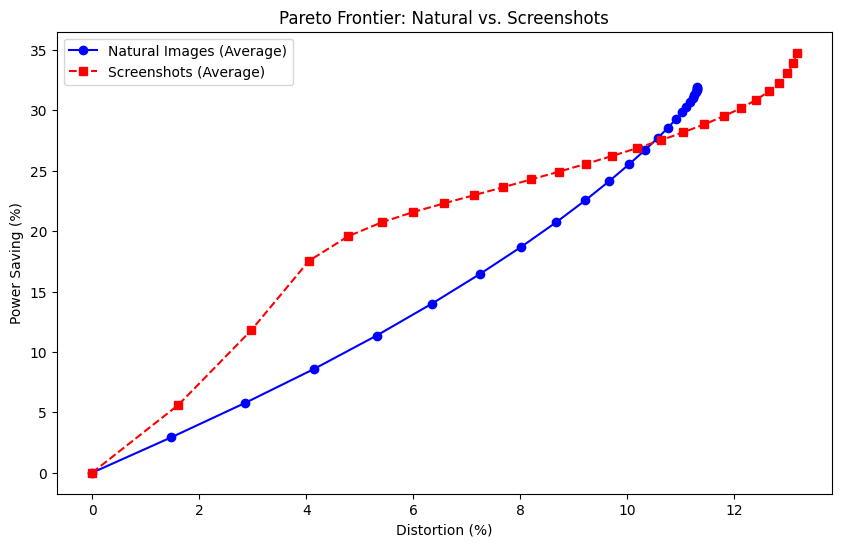

In [49]:
plt.figure(figsize=(10, 6))
# 画自然图像组
x_nat = [r[0] for r in results_natural]
y_nat = [r[1] for r in results_natural]
plt.plot(x_nat, y_nat, 'b-o', label='Natural Images (Average)')

# 画截图组
x_scr = [r[0] for r in results_screens]
y_scr = [r[1] for r in results_screens]
plt.plot(x_scr, y_scr, 'r--s', label='Screenshots (Average)')

plt.title('Pareto Frontier: Natural vs. Screenshots')
plt.xlabel('Distortion (%)')
plt.ylabel('Power Saving (%)')
plt.legend()
plt.show()

In [50]:
import pandas as pd

img49 = images[49]
p_orig = compute_power(img49)

# 先看各通道的实际像素均值和功率占比
r49, g49, b49 = img49[:,:,0].astype(np.float64), img49[:,:,1].astype(np.float64), img49[:,:,2].astype(np.float64)
gamma_pow = 0.7755
w_r, w_g, w_b = 2.13636845e-7, 1.77746705e-7, 2.14348309e-7

p_r = w_r * np.sum(np.power(r49, gamma_pow))
p_g = w_g * np.sum(np.power(g49, gamma_pow))
p_b = w_b * np.sum(np.power(b49, gamma_pow))

print(f"=== Image 49 通道分析 ===")
print(f"R: 均值={r49.mean():.1f}, 功率占比={p_r/p_orig*100:.1f}%")
print(f"G: 均值={g49.mean():.1f}, 功率占比={p_g/p_orig*100:.1f}%")
print(f"B: 均值={b49.mean():.1f}, 功率占比={p_b/p_orig*100:.1f}%")
print()

# 三种策略逐参数对比
rows = []
for k in [0, 20, 40, 60, 80, 100]:
    img_new = wrapper_hungry_blue(img49, k)
    p_new = compute_power(img_new)
    rows.append({"Strategy": "Hungry Blue", "Param": f"k={k}",
                 "Saving(%)": round((p_orig-p_new)/p_orig*100, 3),
                 "Distortion(%)": round(compute_distortion(img49, img_new), 3)})

for c in [1.0, 0.9, 0.8, 0.7, 0.6, 0.5]:
    img_new = wrapper_brightness(img49, c)
    p_new = compute_power(img_new)
    rows.append({"Strategy": "Brightness", "Param": f"c={c}",
                 "Saving(%)": round((p_orig-p_new)/p_orig*100, 3),
                 "Distortion(%)": round(compute_distortion(img49, img_new), 3)})

for g in [1.0, 1.2, 1.4, 1.6, 1.8, 2.0]:
    img_new = wrapper_gamma(img49, g)
    p_new = compute_power(img_new)
    rows.append({"Strategy": "Gamma", "Param": f"γ={g}",
                 "Saving(%)": round((p_orig-p_new)/p_orig*100, 3),
                 "Distortion(%)": round(compute_distortion(img49, img_new), 3)})

df = pd.DataFrame(rows)
print(df.to_string(index=False))


=== Image 49 通道分析 ===
R: 均值=58.1, 功率占比=23.3%
G: 均值=92.8, 功率占比=31.6%
B: 均值=114.6, 功率占比=45.1%

   Strategy Param  Saving(%)  Distortion(%)
Hungry Blue   k=0      0.000          0.000
Hungry Blue  k=20      6.503          3.347
Hungry Blue  k=40     13.199          6.543
Hungry Blue  k=60     19.950          9.451
Hungry Blue  k=80     26.537         11.937
Hungry Blue k=100     32.566         13.929
 Brightness c=1.0      0.315          0.091
 Brightness c=0.9      8.383          1.285
 Brightness c=0.8     16.379          2.551
 Brightness c=0.7     24.726          3.862
 Brightness c=0.6     33.256          5.193
 Brightness c=0.5     42.076          6.553
      Gamma γ=1.0      0.315          0.091
      Gamma γ=1.2      9.920          1.527
      Gamma γ=1.4     18.200          2.829
      Gamma γ=1.6     25.563          3.978
      Gamma γ=1.8     32.139          4.994
      Gamma γ=2.0     38.005          5.886
